## 1. Install Required Packages

In [ ]:
!pip install rapidfuzz unidecode sentence_transformers==3.0.1 scikit-learn==1.5.1 \
 lightgbm==4.4.0 catboost==1.2.5 ipywidgets --no-deps --quiet
%pip install sentence_transformers
!pip install dython --quiet
!pip install numpy pandas seaborn matplotlib --quiet
!pip install IPython tqdm python-dateutil catboost scikit-learn ipywidgets --quiet
!pip install optuna

In [22]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from IPython.display import display, HTML, display_html
import unicodedata
import time
from dateutil import parser
from tqdm.notebook import tqdm
import catboost
from catboost import CatBoostRegressor
import joblib

from dython.nominal import associations
from sentence_transformers import SentenceTransformer
from sklearn.decomposition import TruncatedSVD

## 2. Normalization Helper Function

In [23]:
import unicodedata

def normalize_string(s: str) -> str:
    """
    Türkçe karakterleri Latin alfabesindeki karşılıklarına çevirir,
    Unicode normalizasyonu (NFKD) yaparak aksanları kaldırır,
    metni küçük harfe çevirir, baştaki/sondaki boşlukları temizler,
    ve metinden "universitesi" kelimesini çıkarır.
    """
    if not isinstance(s, str):
        return s

    turkish_chars = {
        'ç': 'c', 'ğ': 'g', 'ı': 'i', 'ö': 'o', 'ş': 's', 'ü': 'u',
        'Ç': 'C', 'Ğ': 'G', 'İ': 'I', 'Ö': 'O', 'Ş': 'S', 'Ü': 'U'
    }
    # Unicode normalizasyonu: aksan işaretlerini ayırır.
    normalized = unicodedata.normalize('NFKD', s)
    # Aksan işaretlerini kaldırır.
    without_accents = ''.join(c for c in normalized if not unicodedata.combining(c))
    # Türkçe karakterleri dönüştürür.
    replaced = ''.join(turkish_chars.get(c, c) for c in without_accents)
    # NFC normalizasyonu, küçük harfe çevirme, "universitesi" kaldırma ve boşlukları temizleme.
    return unicodedata.normalize('NFC', replaced).lower().replace("universitesi", "").strip()


## 3. Data Import & Cleaning

In [24]:
path = ""

train_raw = pd.read_csv(path + "train.csv").drop("id", axis=1).applymap(normalize_string)
test_raw = pd.read_csv(path + "test_x.csv").drop("id", axis=1).applymap(normalize_string)
sub = pd.read_csv(path + "sample_submission.csv")

# Clean up column names: lowercase, replace spaces with underscores, remove punctuation.
train_raw.columns = (
    train_raw.columns
             .str.lower()
             .str.replace(' ', '_')
             .str.replace(r'\W', '', regex=True)    # this removes non-alphanumeric characters (like punctuation)
)
test_raw.columns = (
    test_raw.columns
             .str.lower()
             .str.replace(' ', '_')
             .str.replace(r'\W', '', regex=True)
)

## 4. EDA

In [35]:
print(" Sütünlar ve tamamen NaN olan yıllar:")
print("-"*50)
print()

all_df = pd.concat([train_raw, test_raw], ignore_index=True)

colnan_dict = {col:[] for col in all_df.columns}

for year in all_df["basvuru_yili"].unique():
    year_df = all_df[all_df["basvuru_yili"]==year]
    year_df_na_counts = year_df.isna().sum()
    nan_cols = list(year_df_na_counts[year_df_na_counts==len(year_df)].index)

    for nan_col in nan_cols:
        colnan_dict[nan_col].append(year)

for col, years in colnan_dict.items():
    if len(years)>0:
        print(col, years)


 Sütünlar ve tamamen NaN olan yıllar:
--------------------------------------------------

degerlendirme_puani [2023]
burslu_ise_burs_yuzdesi [2022, 2023]
daha_once_baska_bir_universiteden_mezun_olmus [2017, 2020, 2021, 2022, 2023]
lise_adi_diger [2014, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]
lise_bolum_diger [2014, 2020, 2021, 2022, 2023]
lise_mezuniyet_notu [2016]
anne_calisma_durumu [2021]
baba_calisma_durumu [2021]
uye_oldugunuz_kulubun_ismi [2019, 2020, 2021, 2022, 2023]
aktif_olarak_bir_stk_üyesi_misiniz [2021]
hangi_stknin_uyesisiniz [2017, 2021]
stk_projesine_katildiniz_mi [2020, 2021, 2022, 2023]
girisimcilikle_ilgili_deneyiminiz_var_mi [2021]
girisimcilikle_ilgili_deneyiminizi_aciklayabilir_misiniz [2016, 2017, 2018, 2019, 2021]
ingilizce_biliyor_musunuz [2014]
ingilizce_seviyeniz [2014, 2020, 2021, 2022, 2023]
daha_önceden_mezun_olunduysa_mezun_olunan_üniversite [2014, 2015, 2017, 2020, 2021, 2022, 2023]


In [ ]:
import re
from sklearn.model_selection import cross_val_score
from lightgbm import LGBMClassifier

# Örnek olarak orijinal veri setimizden kopya alıyoruz.
advval_df = train_raw.copy()  # veya train_final yerine train_raw kullanabilirsiniz

# Kategorik sütunları belirleyip eksik değerleri dolduruyoruz
cat_cols = [col for col in advval_df.columns if advval_df[col].dtype == object]
for col in cat_cols:
    advval_df[col] = advval_df[col].fillna("nan").astype(str).astype("category")

# Sütun isimlerini temizle: yalnızca harf, rakam ve alt çizgi içersin
advval_df = advval_df.rename(columns=lambda x: re.sub('[^A-Za-z0-9_]+', '', x))

# Model girdilerinde kullanılmayacak sütunları kaldırıyoruz.
# 'basvuru_yili' hedef değişken olarak kullanılacak, 
# 'degerlendirme_puani' ve varsa fold id sütunlarını çıkarıyoruz.
features = advval_df.drop(columns=['basvuru_yili', 'degerlendirme_puani'], errors='ignore')

# Hedef değişken: burada 'basvuru_yili' kullanılmakta.
target = advval_df['basvuru_yili']
if target.dtype == 'object':
    target = target.astype(int)

# LightGBM sınıflandırıcısı ile 5 katlı cross-validation ve roc_auc_ovr skoru
scores = cross_val_score(
    LGBMClassifier(n_estimators=1, verbosity=-1),
    features,
    target,
    scoring="roc_auc_ovr", # OVR means One-Versus-Rest 
    cv=5
)
print("Cross-validation ROC AUC score:", scores.mean())



Cross-validation ROC AUC scores: 0.9960519266559587


In [4]:
train_raw.head()

,basvuru_yili,degerlendirme_puani,cinsiyet,dogum_tarihi,dogum_yeri,ikametgah_sehri,universite_adi,universite_turu,burslu_ise_burs_yuzdesi,burs_aliyor_mu,...,profesyonel_bir_spor_daliyla_mesgul_musunuz,spor_dalindaki_rolunuz_nedir,aktif_olarak_bir_stk_üyesi_misiniz,hangi_stknin_uyesisiniz,stk_projesine_katildiniz_mi,girisimcilikle_ilgili_deneyiminiz_var_mi,girisimcilikle_ilgili_deneyiminizi_aciklayabilir_misiniz,ingilizce_biliyor_musunuz,ingilizce_seviyeniz,daha_önceden_mezun_olunduysa_mezun_olunan_üniversite
0,2014,52.0,erkek,4/6/1994,"altindag, ankara",ankara,ihsan dogramaci bilkent,ozel,100.0,evet,...,evet,diger,hayir,NaN,evet,hayir,NaN,NaN,NaN,NaN
1,2014,30.0,erkek,6/11/1993,uskudar,istanbul,ihsan dogramaci bilkent,ozel,100.0,hayir,...,hayir,0,hayir,NaN,evet,evet,bilkent cyberparkta bir sirkette turkiye nin i...,NaN,NaN,NaN
2,2014,18.0,erkek,1/15/1986,samsun,istanbul,uluslararasi kibris,ozel,100.0,hayir,...,hayir,0,hayir,NaN,hayir,hayir,NaN,NaN,NaN,NaN
3,2014,40.0,erkek,6/4/1991,diyarbakir,istanbul,istanbul sehir,ozel,100.0,evet,...,hayir,0,hayir,NaN,evet,hayir,NaN,NaN,NaN,NaN
4,2014,24.0,erkek,2 kasim 1992,ankara/altindag,ankara,turgut ozal,ozel,100.0,evet,...,hayir,0,hayir,NaN,hayir,hayir,NaN,NaN,NaN,NaN


In [5]:
train_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65125 entries, 0 to 65124
Data columns (total 43 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   basvuru_yili                                              65125 non-null  int64  
 1   degerlendirme_puani                                       65124 non-null  float64
 2   cinsiyet                                                  64956 non-null  object 
 3   dogum_tarihi                                              64948 non-null  object 
 4   dogum_yeri                                                64334 non-null  object 
 5   ikametgah_sehri                                           63088 non-null  object 
 6   universite_adi                                            64993 non-null  object 
 7   universite_turu                                           64870 non-null  object 
 8   burslu_ise_burs_

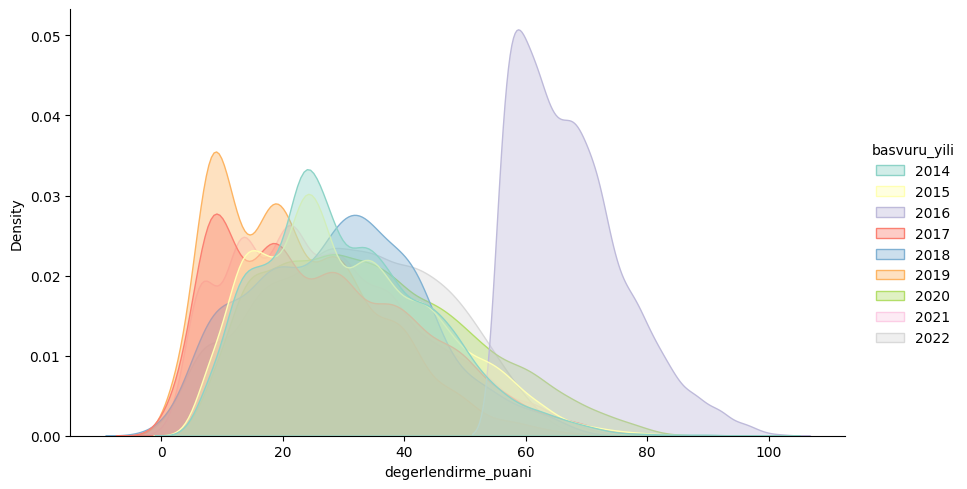

In [7]:
_ = sns.displot(kind='kde',
                data=train_raw,
                x="degerlendirme_puani",
                hue="basvuru_yili",
                height=5,
                aspect=1.75,
                fill=True,
                common_norm=False,
                alpha=0.4,
                palette="Set3"
               )

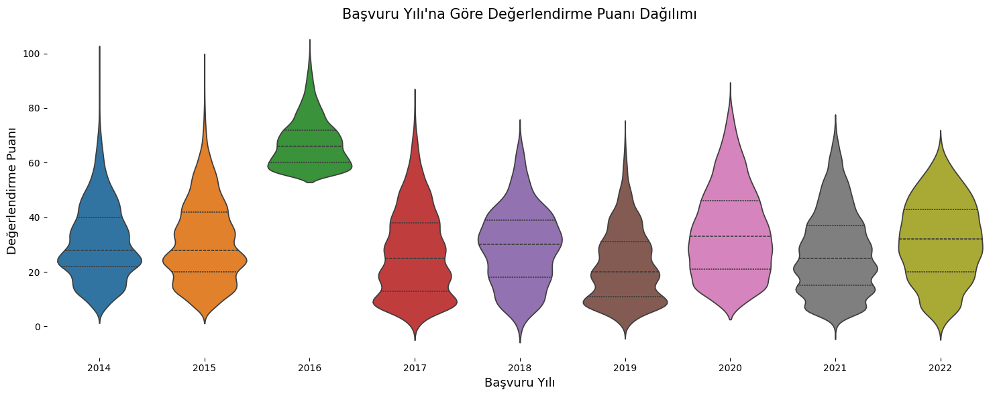

In [8]:
plt.figure(figsize=(15, 6))
sns.violinplot(data=train_raw, x='basvuru_yili', y='degerlendirme_puani', palette='tab10', inner='quartile')

plt.title("Başvuru Yılı'na Göre Değerlendirme Puanı Dağılımı", fontsize=15)
plt.xlabel("Başvuru Yılı", fontsize=13)
plt.ylabel("Değerlendirme Puanı", fontsize=13)

ax = plt.gca() 
for spine in ax.spines.values():
    spine.set_visible(False)
    
plt.tight_layout()    
plt.show()

In [10]:
null_counts = train_raw.isnull().sum()
null_counts.sort_values()

basvuru_yili                                                    0
burs_aliyor_mu                                                  0
degerlendirme_puani                                             1
universite_adi                                                132
cinsiyet                                                      169
dogum_tarihi                                                  177
bölüm                                                         231
baska_bir_kurumdan_burs_aliyor_mu                             231
universite_turu                                               255
universite_kacinci_sinif                                      374
lise_adi                                                      384
anne_egitim_durumu                                            406
dogum_yeri                                                    791
lise_turu                                                     847
baba_egitim_durumu                                           1007
lise_bolum

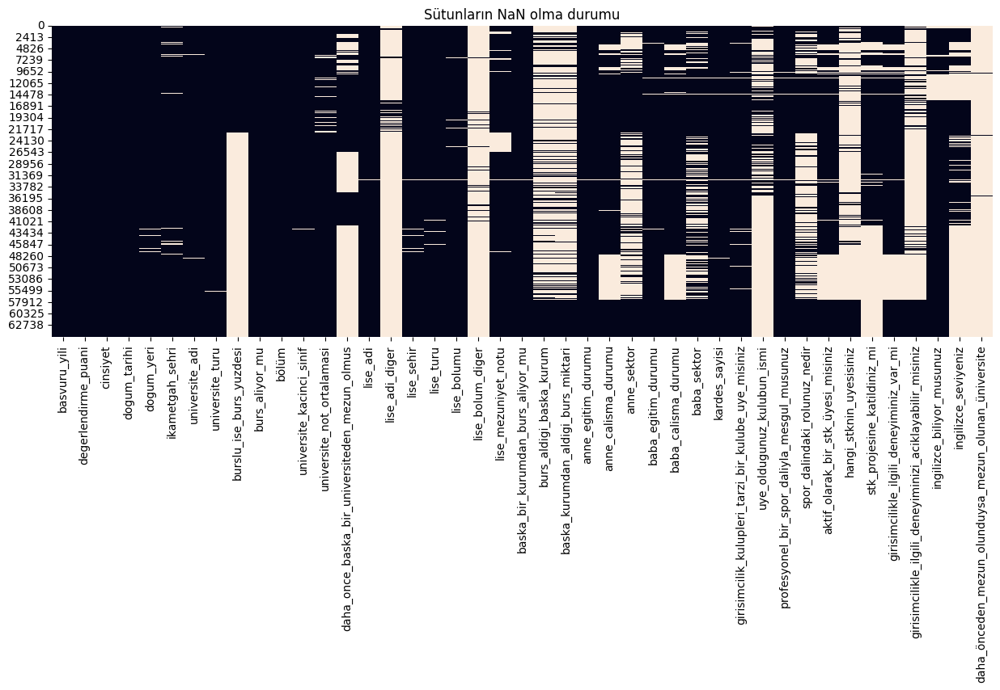

In [11]:
plt.figure(figsize=(15, 5))
sns.heatmap(train_raw.isnull(), cbar=False)
plt.title('Sütunların NaN olma durumu')
plt.show()

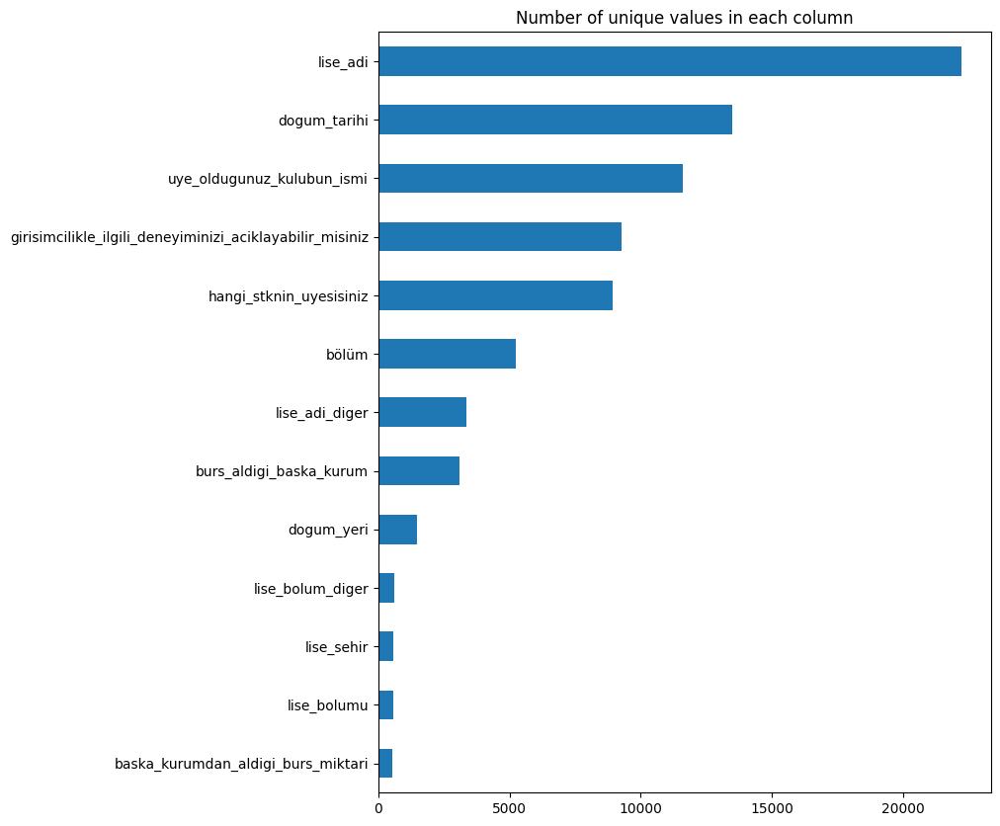

In [16]:
# graph of the number of unique values in each column sorted in descending order if the number of unique values is less than 100 dont show the graph
unique_values = train_raw.nunique()
unique_values = unique_values[unique_values > 500]
unique_values.sort_values().plot.barh(figsize=(8, 10))
plt.title("Number of unique values in each column")
plt.show()



## 6. Selecting Subset of Data and Remove NaN Columns

In [49]:
# We focus on year 2022 for training because it has the most complete data
train_2022 = train_raw[train_raw["basvuru_yili"] == 2022].dropna(subset=["degerlendirme_puani"]).reset_index(drop=True)

# Identify columns that are completely empty in the 2023 test data
test_replaced = test_raw.replace("-", np.NaN)                    # Replace "-" with NaN
null_counts_test = test_replaced.isnull().sum()                  # Count NaNs in test data
drop_cols = test_raw.columns[null_counts_test == len(test_raw)]  # Columns with all NaNs

# Drop these columns from both train_2022 and test
train_2022 = train_2022.drop(drop_cols, axis=1)
test_cleaned = test_raw.drop(drop_cols, axis=1)

## 7. Feature Engineering

In [50]:
def standardize_data(data: pd.DataFrame) -> pd.DataFrame:
    """Veriyi standart hale getirir: kategorileri normalize eder, eksik değerleri işler."""
    
    data = data.copy()  # Orijinal veriyi değiştirmemek için kopyasını al
    
    # "-" olan değerleri "bos" ile değiştir (eksik veri belirtilmiş olabilir)
    data.replace("-", "bos", inplace=True)

    ### Burs Kategorilerini Standartlaştırma ###
    
    burs_map = {"yurt": "kyk", "devlet": "kyk", "bakan": "kyk", "gsb": "kyk"}
    burs_turleri = ["kyk", "devlet", "vakf", "koc", "meb", "bakan", "derne", "gsb", "yurt", "tev", "tubitak", "bos"]

    def extract_burs(value):
        """Burs türünü metin içinden çıkartır ve standart forma getirir."""
        if pd.isna(value):
            return np.nan
        for burs in burs_turleri:
            if burs in value:
                return burs_map.get(burs, burs)  # Eşleşen kelimeyi haritadan al, yoksa olduğu gibi bırak
        return np.nan

    data["bu_rs_kurumu"] = data["burs_aldigi_baska_kurum"].apply(extract_burs)

    ### Lise Türlerini Standartlaştırma ###
    
    lise_map = {
        "meslek": "devlet", "ozel": "ozel", "devlet": "devlet", "diger": "devlet",
        "anadolu lisesi": "devlet", "meslek lisesi": "devlet", "ozel lisesi": "ozel",
        "fen lisesi": "ozel", "imam hatip lisesi": "devlet", "duz lise": "devlet"
    }
    data["lise_turu"] = data["lise_turu"].replace(lise_map)

    ### Ebeveyn Eğitim Durumlarını Standartlaştırma ###
    
    edu_map = {
        "ilkokul mezunu": "ilkokul", "yuksek lisans / doktora": "yuksek lisans",
        "ortaokul mezunu": "ortaokul", "0": "egitimi yok", "egitim yok": "egitimi yok",
        "lise mezunu": "lise", "universite mezunu": "universite", "yuksek lisans / doktara": "yuksek lisans"
    }
    data[["anne_egitim_durumu", "baba_egitim_durumu"]] = data[["anne_egitim_durumu", "baba_egitim_durumu"]].replace(edu_map)

    ### Spor Dalındaki Rolü Standartlaştırma ###
    
    data["spor_dalindaki_rolunuz_nedir"] = data["spor_dalindaki_rolunuz_nedir"].replace({
        'kaptan / lider': 'lider/kaptan', 'kaptan': 'lider/kaptan', '0': 'bos'
    })

    ## Üniversite Not Aralıklarını Sayısala Çevirme ##

    notlar = {
        "1.00 - 2.50": 1.5, "2.50 - 2.99": 2.75, "3.00 - 3.49": 3.25, "1.80 - 2.49": 2.25,
        "hazirligim": np.NaN, "0 - 1.79": 1.5, "2.00 - 2.50": 2.25, "3.50 - 4.00": 3.75,
        "not ortalamasi yok": np.NaN, "4.0-3.5": 3.75, "2.50 ve alti": 2.0, "3.00 - 4.00": 3.5
    }
    data["universite_not_ortalamasi"] = data["universite_not_ortalamasi"].replace(notlar)
    data["universite_not_ortalamasi"] = pd.to_numeric(data["universite_not_ortalamasi"], errors="coerce")

    ### Üniversite Sınıf Bilgisini Sayısala Çevirme ###
    
    # "hazirlik" kelimesini "0" ile değiştir
    data["universite_kacinci_sinif"] = data["universite_kacinci_sinif"].str.replace("hazirlik", "0", regex=False)
    data["universite_kacinci_sinif"] = pd.to_numeric(data["universite_kacinci_sinif"], errors="coerce")

    ### Burs Miktarını Sayısala Çevirme
    baska_burs_map = {
        'bos': 0.0, 
        '0-499₺': 1.0,
        '0 - 499 ₺': 1.0,
        '0 - 499₺' : 1.0,
        '500₺ - 999₺': 2.0,
        '1000₺ ve ustu': 4.0
    }

    # Burs miktarını sayısal hale getir
    data['baska_kurumdan_aldigi_burs_miktari'] = data['baska_kurumdan_aldigi_burs_miktari'].replace(baska_burs_map)
    data['baska_kurumdan_aldigi_burs_miktari'] = pd.to_numeric(data['baska_kurumdan_aldigi_burs_miktari'], errors="coerce")
        
    return data


In [51]:
new_train_2022 = standardize_data(train_2022)
new_test_cleaned = standardize_data(test_cleaned)

In [52]:
def feature_engineering(data: pd.DataFrame) -> pd.DataFrame:
    """Yeni değişkenler oluşturur ve istatistiksel dönüşümler yapar."""
    
    data = data.copy()

    ### Yaş Hesaplama ###
    data["dogum_tarihi"] = pd.to_datetime(data["dogum_tarihi"], errors="coerce")  # Doğum tarihini datetime formatına çevir
    data["basvuru_yasi"] = data["basvuru_yili"] - data["dogum_tarihi"].dt.year  # Başvuru yılından doğum yılını çıkararak yaş hesapla
    data.loc[(data["basvuru_yasi"] < 16) | (data["basvuru_yasi"] > 27), "basvuru_yasi"] = np.NaN  # Yaş sınırları dışında kalanları NaN yap

    ### Kardeş Sayısını Sayısala Çevirme ###
    data["kardes_sayisi"] = pd.to_numeric(data["kardes_sayisi"], errors="coerce").fillna(0).astype(int)  # Sayıya çevir, eksikleri 0 yap

    ### Genel Aktiflik Skoru (Toplam Aktivite Sayısı) ###
    activity_cols = [
        "girisimcilik_kulupleri_tarzi_bir_kulube_uye_misiniz",
        "girisimcilikle_ilgili_deneyiminiz_var_mi",
        "aktif_olarak_bir_stk_üyesi_misiniz",
        "profesyonel_bir_spor_daliyla_mesgul_musunuz",
        "ingilizce_biliyor_musunuz"
    ]
    data[activity_cols] = data[activity_cols].replace({"evet": True, "hayir": False})
    data["genel_aktiflik"] = data[activity_cols].sum(axis=1)  # Toplamını al

    ### Lise Tür Kategorisi Extraction ###
    lise_turleri = [
        "fen", "imam", "saglik", "meslek", "anadolu", "haydarpasa", "sosyal", 
        "sanat", "spor", "acik", "kolej", "temel", "kiz", "erkek", "ataturk", "galatasaray"
    ]

    # Lise kategorisini belirleyen fonksiyon
    def lise_turu_bul(lise_adi):
        lise_adi = lise_adi.lower()  # Küçük harfe çevir
        for tur in lise_turleri:
            if tur in lise_adi:
                return tur
        return "bos"  # Hiçbiri yoksa "bos" döndür

    # Apply ile tüm satırlara uygula
    data["lise_kategorisi"] = data["lise_adi"].apply(lise_turu_bul)


    ### Bölüm Kategorisi Extraction ###
    # Bölüm türleri listesi
    bolumler = [
        "tip", "ogretmen", "dil", "yonetim", "sanat", "isletme", "sosyo", "ekonomi", "fizyo", "cocuk", "sosyal",
        "tarih", "cografya", "odyoloji", "muhendis", "ecza", "hukuk", "hemsire", "diger", "maliye", "ebe",
        "istatistik", "beslenme", "islam", "veteriner", "plan", "yazilim", "banka", "ticaret", "radyo",
        "gazete", "felsefe", "spor", "tercuman", "endus", "fizik", "bilim", "peyzaj", "turizm", "medya",
        "tekno", "tasarim", "ilahiyat", "iktisat", "hekim", "matematik", "mimarlik", "biyoloji", "kimya",
        "iliski", "iletisim"
    ]

    # Bölüm kategorisini belirleyen fonksiyon
    def bolum_bul(bolum_adi):
        bolum_adi = bolum_adi.lower()  # Küçük harfe çevir
        for bolum in bolumler:
            if bolum in bolum_adi:
                return bolum
        return "diger"  # Hiçbiri yoksa "diger" döndür
    # Apply ile tüm satırlara uygula
    data["bölüm_kategorisi"] = data["bölüm"].apply(bolum_bul)

    
    ### Sayısal Sütunları Doğrulama ve Dönüştürme ###
    data["lise_mezuniyet_notu"] = data["lise_mezuniyet_notu"].replace({
        "0 - 24": 12, "25 - 49": 37, "50 - 74": 62, "75 - 100": 87
    }).astype(int)

    data["universite_not_ortalamasi"] = pd.to_numeric(data["universite_not_ortalamasi"], errors="coerce")
    data["universite_kacinci_sinif"] = pd.to_numeric(data["universite_kacinci_sinif"], errors="coerce")
    
    ### Ağırlıklı Üniversite Notu ###
    sinif_katsayi = {5: 4, 6: 4, 0: 1}  # 5. ve 6. sınıfları 4. sınıf, hazırlık sınıfını 1. sınıf olarak değerlendir
    data["universite_kacinci_sinif"] = data["universite_kacinci_sinif"].replace(sinif_katsayi)
    data["universite_derecesi"] = data["universite_not_ortalamasi"] * data["universite_kacinci_sinif"]

    ### İkamet Şehri ve Doğum Yerinin Aynı Olup Olmadığı ###
    data["is_it_same_sehir"] = data["ikametgah_sehri"] == data["dogum_yeri"]  # İkamet ve doğum şehirleri aynı mı?

    ### Metin Uzunluğu (Kelime Sayısı) ###
    data["girisim_metni_kelime_sayisi"] = data["girisimcilikle_ilgili_deneyiminizi_aciklayabilir_misiniz"].str.split().apply(lambda x: len(x) if isinstance(x, list) else np.NaN)  # Girişimcilik metnindeki kelime sayısı
    data["stk_metni_kelime_sayisi"] = data["hangi_stknin_uyesisiniz"].str.split().apply(lambda x: len(x) if isinstance(x, list) else np.NaN)  # STK metnindeki kelime sayısı

    
    # Grup bazlı karşılaştırmalardan önce veri tiplerini numeric yap
    data["universite_not_ortalamasi"] = pd.to_numeric(data["universite_not_ortalamasi"], errors="coerce")
    data["lise_mezuniyet_notu"] = pd.to_numeric(data["lise_mezuniyet_notu"], errors="coerce")
    data["universite_kacinci_sinif"] = pd.to_numeric(data["universite_kacinci_sinif"], errors="coerce")
    
    ### Grup Bazlı Karşılaştırmalar ###
    data["uni_basarisi_digerlerine_gore"] = data.groupby("universite_kacinci_sinif")["universite_not_ortalamasi"].transform("mean") - data["universite_not_ortalamasi"]  # Aynı sınıftaki ortalama not ile farkı
    data["lise_basarisi_digerlerine_gore"] = data.groupby("lise_kategorisi")["lise_mezuniyet_notu"].transform("mean") - data["lise_mezuniyet_notu"]  # Aynı lise türündeki ortalama ile farkı
    data["bölüm_digerlerine_gore"] = data.groupby("bölüm_kategorisi")["universite_not_ortalamasi"].transform("mean") - data["universite_not_ortalamasi"]  # Aynı bölümdeki ortalama ile farkı

    ### Başarı İvmesi ###
    data["basari_ivmesi"] = (data["universite_not_ortalamasi"] * 25 - data["lise_mezuniyet_notu"]) / (data["lise_mezuniyet_notu"] + 1e-4)  # Lise ve üniversite notları arasındaki değişimi ölç

    ### Sentence-BERT ile Metin Gömme (Embedding) ###
    model = SentenceTransformer("atasoglu/turkish-tiny-bert-uncased-mean-nli-stsb-tr")  # Hafif ve hızlı model

    data["text_embedding"] = data["girisimcilikle_ilgili_deneyiminizi_aciklayabilir_misiniz"].fillna("").apply(lambda x: model.encode(x))  # Metinleri vektöre dönüştür

    ### Embedding Boyutunu 5'e İndirme ###
    embeddings = np.vstack(data["text_embedding"].values)# Listeyi numpy dizisine çevir
    svd = TruncatedSVD(n_components=5)                   # 5 boyuta indir
    reduced_embeddings = svd.fit_transform(embeddings)   # Boyutu küçült
    joblib.dump(svd, 'svd_model.pkl')  # SVD modelini kaydet

    embedding_cols = [f"nn_emb_{i}" for i in range(reduced_embeddings.shape[1])]  # Yeni sütun isimleri
    data[embedding_cols] = reduced_embeddings            # Embedding değerlerini DataFrame'e ekle
    data.drop(columns=["text_embedding"], inplace=True)  # Geçici sütunu kaldır

    ### Kullanılmayan Sütunları Kaldırma ###
    drop_columns = [
        "girisimcilikle_ilgili_deneyiminizi_aciklayabilir_misiniz",  # Girişimcilik deneyimi metni artık kullanılmıyor
        "hangi_stknin_uyesisiniz",  # STK bilgisi metni artık kullanılmıyor
        "dogum_tarihi",  # Doğum tarihi yerine yaş kullanıldığı için gereksiz
        "basvuru_yili" , # Başvuru yılı yerine yaş hesaplandığı için gereksiz
        "anne_calisma_durumu",      # gereksiz
        "baba_calisma_durumu",      # gereksiz
    ] + [col for col in data.columns if "burs" in col]  # Burs bilgisiyle ilgili tüm sütunları kaldır

    data.drop(drop_columns, axis=1, errors="ignore", inplace=True)  # Belirtilen sütunları sil, hata olursa yok say

    return data


In [162]:
train_final = feature_engineering(new_train_2022)
test_final = feature_engineering(new_test_cleaned)

## 8. Preperation for Modeling

### Manuel Feature Selection 

In [174]:
train_final_2 = feature_engineering(new_train_2022)
test_final_2 = feature_engineering(new_test_cleaned)

In [210]:
train_final = train_final_2.copy()
test_final = test_final_2.copy()

In [211]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_squared_error, make_scorer, root_mean_squared_error
from catboost import CatBoostRegressor
import lightgbm as lgb

# 1. Handle Categorical Features
# drop columns universite türü , üniversite kaçıncı sınıf , lise mezuniyet notu, lise türü , nn_embedding4, girişimcilikle ilgili deneyiminiz var mı , nn_embedding2 ve anne sektör 

train_final = train_final.drop(columns=["universite_turu", "universite_kacinci_sinif", "lise_mezuniyet_notu", "lise_turu", "nn_emb_4", "girisimcilikle_ilgili_deneyiminiz_var_mi", "anne_sektor","nn_emb_2"])
test_final = test_final.drop(columns=["universite_turu", "universite_kacinci_sinif", "lise_mezuniyet_notu", "lise_turu", "nn_emb_4", "girisimcilikle_ilgili_deneyiminiz_var_mi", "anne_sektor","nn_emb_2"])

cat_features = train_final.select_dtypes("object").columns.to_list()

# Fill missing values with 'diger'
train_final[cat_features] = train_final[cat_features].fillna("diger")
test_final[cat_features] = test_final[cat_features].fillna("diger")

# Convert categorical features to 'category' dtype for LightGBM
train_final[cat_features] = train_final[cat_features].astype("category")
test_final[cat_features] = test_final[cat_features].astype("category")

# FINAL DATA SPLITTING
X = train_final.drop("degerlendirme_puani", axis=1)
y = train_final["degerlendirme_puani"]

print("Train shape:", X.shape, "Target shape:", y.shape)
print("Test shape:", test_final.shape)



Train shape: (7621, 34) Target shape: (7621,)
Test shape: (11049, 34)


In [178]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics import mean_squared_error, make_scorer
from catboost import CatBoostRegressor
import lightgbm as lgb
from sklearn.linear_model import Ridge
from sklearn.ensemble import StackingRegressor
import optuna
import joblib
import warnings
warnings.filterwarnings("ignore")

# ------------------------------
# 0. Veri Hazırlığı
# ------------------------------
# Varsayım: X (özellikler), y (hedef değişken),
# cat_features (kategorik sütun isimleri) ve test_final (test verisi)
# daha önceden hazırlanmış durumda.
print(">>> Veri seti hazır. Özellikler:", X.columns.tolist())
print(">>> Kategorik özellikler:", cat_features)

# Bu örnekte tüm özellikler kullanılacaktır.
X_model = X.copy()  # Özellik seçimi yapılmıyor, tüm sütunlar kullanılıyor.
cat_features_model = cat_features  # Tüm kategorik sütunlar kullanılacak.

# ------------------------------
# 1. CV Stratejisi ve RMSE Skoru
# ------------------------------
print(">>> CV stratejisi ve RMSE skoru tanımlanıyor...")
cv_strategy = KFold(n_splits=3, shuffle=True, random_state=42)
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
rmse_scorer = make_scorer(rmse, greater_is_better=False)

# ------------------------------
# 2. Optuna Objective Fonksiyonları
# ------------------------------
def objective_cat(trial):
    params = {
        'iterations': trial.suggest_int("iterations", 700, 1500, step=100),
        'depth': trial.suggest_int("depth", 4, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.006, 0.02),
        'l2_leaf_reg': trial.suggest_loguniform("l2_leaf_reg", 1e-1, 10),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_seed': 42,
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        model = CatBoostRegressor(**params, cat_features=cat_features_model)
        model.fit(X_train, y_train, eval_set=(X_valid, y_valid))
        preds = model.predict(X_valid)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))
        #if trial.should_prune():                    # Optuna'nın trial'ı durdurup durdurmayacağını kontrol et (early stopping) 
        #    raise optuna.exceptions.TrialPruned()
    mean_score = np.mean(cv_scores)
    print(f"CatBoost denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

def objective_lgb(trial):
    params = {
        'n_estimators': trial.suggest_int("n_estimators", 700, 1500, step=100),
        'max_depth': trial.suggest_int("max_depth", -1, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.008, 0.01),
        'num_leaves': trial.suggest_int("num_leaves", 10, 60),
        'min_child_samples': trial.suggest_int("min_child_samples", 5, 40),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_state': 42
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        model = lgb.LGBMRegressor(**params)
        model.fit(X_train, y_train, eval_set=[(X_valid, y_valid)])
        preds = model.predict(X_valid)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))
        #if trial.should_prune():
        #    raise optuna.exceptions.TrialPruned()
    mean_score = np.mean(cv_scores)
    print(f"LightGBM denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

# ------------------------------       
# 3. Hiperparametre Optimizasyonu                           
# ------------------------------
print(">>> Optuna ile CatBoost hiperparametre optimizasyonu başlıyor...")
study_cat = optuna.create_study(direction="minimize")
study_cat.optimize(objective_cat, n_trials=100, timeout=200)
print("CatBoost - En İyi RMSE: {:.4f}".format(study_cat.best_value))
print("CatBoost - En İyi Parametreler:", study_cat.best_params)

print(">>> Optuna ile LightGBM hiperparametre optimizasyonu başlıyor...")
study_lgb = optuna.create_study(direction="minimize")
study_lgb.optimize(objective_lgb, n_trials=100, timeout=200)
print("LightGBM - En İyi RMSE: {:.4f}".format(study_lgb.best_value))
print("LightGBM - En İyi Parametreler:", study_lgb.best_params)

# ------------------------------
# 4. Nihai Model Eğitimi (Tüm Eğitim Verisi Üzerinde)
# ------------------------------
print(">>> Nihai model eğitimi başlıyor...")

# CatBoost için
best_cat_params = study_cat.best_params.copy()
best_cat_params.update({'random_seed': 42, })
final_cat = CatBoostRegressor(**best_cat_params, cat_features=cat_features_model)
final_cat.fit(X_model, y)
joblib.dump(final_cat, "final_catboost_model.pkl")
print("CatBoost modeli eğitim tamamlandı ve kaydedildi: final_catboost_model.pkl")

# LightGBM için
best_lgb_params = study_lgb.best_params.copy()
best_lgb_params.update({'random_state': 42})
final_lgb = lgb.LGBMRegressor(**best_lgb_params)
final_lgb.fit(X_model, y, eval_set=[(X_model, y)])
joblib.dump(final_lgb, "final_lightgbm_model.pkl")
print("LightGBM modeli eğitim tamamlandı ve kaydedildi: final_lightgbm_model.pkl")

[I 2025-02-05 14:56:38,395] A new study created in memory with name: no-name-6db834ae-bae2-4e0f-a4d7-445880171912


>>> Veri seti hazır. Özellikler: ['cinsiyet', 'dogum_yeri', 'ikametgah_sehri', 'universite_adi', 'bölüm', 'universite_not_ortalamasi', 'lise_adi', 'lise_sehir', 'lise_bolumu', 'anne_egitim_durumu', 'anne_sektor', 'baba_egitim_durumu', 'baba_sektor', 'kardes_sayisi', 'girisimcilik_kulupleri_tarzi_bir_kulube_uye_misiniz', 'profesyonel_bir_spor_daliyla_mesgul_musunuz', 'spor_dalindaki_rolunuz_nedir', 'aktif_olarak_bir_stk_üyesi_misiniz', 'ingilizce_biliyor_musunuz', 'bu_rs_kurumu', 'basvuru_yasi', 'genel_aktiflik', 'lise_kategorisi', 'bölüm_kategorisi', 'universite_derecesi', 'is_it_same_sehir', 'girisim_metni_kelime_sayisi', 'stk_metni_kelime_sayisi', 'uni_basarisi_digerlerine_gore', 'lise_basarisi_digerlerine_gore', 'bölüm_digerlerine_gore', 'basari_ivmesi', 'nn_emb_0', 'nn_emb_1', 'nn_emb_2', 'nn_emb_3']
>>> Kategorik özellikler: ['cinsiyet', 'dogum_yeri', 'ikametgah_sehri', 'universite_adi', 'bölüm', 'lise_adi', 'lise_sehir', 'lise_bolumu', 'anne_egitim_durumu', 'anne_sektor', 'baba_e

[I 2025-02-05 15:00:48,039] Trial 0 finished with value: 5.757508966427949 and parameters: {'iterations': 700, 'depth': 8, 'learning_rate': 0.01476052063170155, 'l2_leaf_reg': 1.6023028684890432, 'subsample': 0.6161307078486368}. Best is trial 0 with value: 5.757508966427949.
[I 2025-02-05 15:00:48,039] A new study created in memory with name: no-name-bcedf40a-5cdd-44c3-9136-7e936802a88c


CatBoost - En İyi RMSE: 5.7575
CatBoost - En İyi Parametreler: {'iterations': 700, 'depth': 8, 'learning_rate': 0.01476052063170155, 'l2_leaf_reg': 1.6023028684890432, 'subsample': 0.6161307078486368}
>>> Optuna ile LightGBM hiperparametre optimizasyonu başlıyor...
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001857 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2025-02-05 15:00:53,478] Trial 0 finished with value: 5.99529011778111 and parameters: {'n_estimators': 1000, 'max_depth': 3, 'learning_rate': 0.08720630162254081, 'num_leaves': 61, 'min_child_samples': 41, 'subsample': 0.5212505744787188}. Best is trial 0 with value: 5.99529011778111.


LightGBM denemesi tamamlandı, RMSE: 5.9953
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001662 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001192 seconds.
You can set `force_col_wise=true` to remove the o

[I 2025-02-05 15:01:11,815] Trial 1 finished with value: 5.833686301765702 and parameters: {'n_estimators': 1000, 'max_depth': -1, 'learning_rate': 0.006229073604209375, 'num_leaves': 38, 'min_child_samples': 43, 'subsample': 0.854191117752231}. Best is trial 1 with value: 5.833686301765702.


LightGBM denemesi tamamlandı, RMSE: 5.8337
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001396 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 15:01:14,299] Trial 2 finished with value: 5.744790282136374 and parameters: {'n_estimators': 700, 'max_depth': 2, 'learning_rate': 0.041198881945015725, 'num_leaves': 13, 'min_child_samples': 13, 'subsample': 0.841049063992059}. Best is trial 2 with value: 5.744790282136374.


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001247 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001245 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2385


[I 2025-02-05 15:01:31,150] Trial 3 finished with value: 5.841510670660932 and parameters: {'n_estimators': 700, 'max_depth': 9, 'learning_rate': 0.006409920656927574, 'num_leaves': 52, 'min_child_samples': 23, 'subsample': 0.589527802439799}. Best is trial 2 with value: 5.744790282136374.


LightGBM denemesi tamamlandı, RMSE: 5.8415
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000902 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 15:01:35,780] Trial 4 finished with value: 5.813923086106583 and parameters: {'n_estimators': 800, 'max_depth': 5, 'learning_rate': 0.011449612941292653, 'num_leaves': 22, 'min_child_samples': 44, 'subsample': 0.8684941762127594}. Best is trial 2 with value: 5.744790282136374.


LightGBM denemesi tamamlandı, RMSE: 5.8139
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000789 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 15:01:38,352] Trial 5 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001202 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:01:40,394] Trial 6 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:01:43,193] Trial 7 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001214 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:01:46,815] Trial 8 finished with value: 5.795718537815417 and parameters: {'n_estimators': 1200, 'max_depth': 3, 'learning_rate': 0.007252506167398169, 'num_leaves': 78, 'min_child_samples': 44, 'subsample': 0.9933117593911536}. Best is trial 2 with value: 5.744790282136374.


LightGBM denemesi tamamlandı, RMSE: 5.7957
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001133 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 15:01:49,070] Trial 9 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000727 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:01:49,764] Trial 10 finished with value: 5.724958410476209 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.057317712352026026, 'num_leaves': 13, 'min_child_samples': 9, 'subsample': 0.6685077187158979}. Best is trial 10 with value: 5.724958410476209.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:01:51,130] Trial 11 finished with value: 5.725692389770251 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.055855119337900015, 'num_leaves': 18, 'min_child_samples': 7, 'subsample': 0.6584116377275225}. Best is trial 10 with value: 5.724958410476209.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
LightGBM denemesi tamamlandı, RMSE: 5.7257
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001399 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 15:01:52,430] Trial 12 finished with value: 5.728337742958487 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.07763271883962215, 'num_leaves': 16, 'min_child_samples': 5, 'subsample': 0.6750582273390269}. Best is trial 10 with value: 5.724958410476209.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:01:53,760] Trial 13 finished with value: 5.723699507263517 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.05006484844903261, 'num_leaves': 33, 'min_child_samples': 5, 'subsample': 0.6682124744751702}. Best is trial 13 with value: 5.723699507263517.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:01:56,344] Trial 14 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001315 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:01:57,544] Trial 15 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001274 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:01:58,438] Trial 16 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:01:59,360] Trial 17 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001342 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:01,242] Trial 18 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001381 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:04,424] Trial 19 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001305 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:05,025] Trial 20 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:06,457] Trial 21 finished with value: 5.728239435926348 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.0484928934650441, 'num_leaves': 21, 'min_child_samples': 5, 'subsample': 0.6788260423361032}. Best is trial 13 with value: 5.723699507263517.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:08,056] Trial 22 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001507 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:08,789] Trial 23 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001315 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:09,572] Trial 24 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016584 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:10,605] Trial 25 finished with value: 5.72432452907982 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.06451343855485617, 'num_leaves': 36, 'min_child_samples': 19, 'subsample': 0.7378654284249121}. Best is trial 13 with value: 5.723699507263517.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:12,771] Trial 26 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001460 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:13,954] Trial 27 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001341 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:14,503] Trial 28 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001228 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:15,553] Trial 29 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001424 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:18,191] Trial 30 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001148 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:19,484] Trial 31 finished with value: 5.722308529565229 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.0615989876263083, 'num_leaves': 23, 'min_child_samples': 8, 'subsample': 0.6601579436518846}. Best is trial 31 with value: 5.722308529565229.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:20,870] Trial 32 finished with value: 5.723939398163792 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.06299426050893137, 'num_leaves': 37, 'min_child_samples': 12, 'subsample': 0.6246351080095733}. Best is trial 31 with value: 5.722308529565229.


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001120 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:23,600] Trial 33 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001567 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2025-02-05 15:02:24,330] Trial 34 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001408 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:26,981] Trial 35 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000623 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:27,448] Trial 36 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000599 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


[I 2025-02-05 15:02:28,804] Trial 37 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000553 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:29,243] Trial 38 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001174 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:30,441] Trial 39 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002155 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:33,365] Trial 40 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000568 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:33,961] Trial 41 finished with value: 5.7228188400139715 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.0617419895774984, 'num_leaves': 23, 'min_child_samples': 8, 'subsample': 0.6689116776343015}. Best is trial 31 with value: 5.722308529565229.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:35,394] Trial 42 finished with value: 5.7240189426266355 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.06230365482881216, 'num_leaves': 22, 'min_child_samples': 8, 'subsample': 0.6371082287436913}. Best is trial 31 with value: 5.722308529565229.


LightGBM denemesi tamamlandı, RMSE: 5.7240
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004338 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:36,726] Trial 43 pruned. 
[I 2025-02-05 15:02:36,944] Trial 44 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000604 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:37,310] Trial 45 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:38,309] Trial 46 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000682 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:39,093] Trial 47 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000664 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:40,161] Trial 48 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000931 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:41,525] Trial 49 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:42,025] Trial 50 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000808 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:43,025] Trial 51 finished with value: 5.721706961399971 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.06129365582296102, 'num_leaves': 36, 'min_child_samples': 14, 'subsample': 0.6954296334763201}. Best is trial 51 with value: 5.721706961399971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
LightGBM denemesi tamamlandı, RMSE: 5.7217
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For cate

[I 2025-02-05 15:02:43,690] Trial 52 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:44,642] Trial 53 finished with value: 5.722054729267384 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.05934027052083844, 'num_leaves': 26, 'min_child_samples': 10, 'subsample': 0.6986839729528668}. Best is trial 51 with value: 5.721706961399971.


LightGBM denemesi tamamlandı, RMSE: 5.7221
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001039 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:46,492] Trial 54 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:46,801] Trial 55 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:47,239] Trial 56 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:50,021] Trial 57 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001386 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:02:53,019] Trial 58 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001930 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2025-02-05 15:02:53,569] Trial 59 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000598 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:54,002] Trial 60 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:54,752] Trial 61 finished with value: 5.723117255479046 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.06430246774370423, 'num_leaves': 20, 'min_child_samples': 8, 'subsample': 0.6343740693330869}. Best is trial 51 with value: 5.721706961399971.


LightGBM denemesi tamamlandı, RMSE: 5.7231
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001751 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 15:02:55,314] Trial 62 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:02:56,241] Trial 63 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:56,568] Trial 64 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002507 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:57,947] Trial 65 finished with value: 5.722951670378072 and parameters: {'n_estimators': 1000, 'max_depth': 1, 'learning_rate': 0.07077463557799211, 'num_leaves': 33, 'min_child_samples': 11, 'subsample': 0.6779961334642138}. Best is trial 51 with value: 5.721706961399971.


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:02:58,477] Trial 66 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000922 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:03:00,429] Trial 67 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001746 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:01,087] Trial 68 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_fe

[I 2025-02-05 15:03:02,225] Trial 69 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000885 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:02,982] Trial 70 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001158 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:04,628] Trial 71 finished with value: 5.720697103828105 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.06671836595590427, 'num_leaves': 34, 'min_child_samples': 14, 'subsample': 0.6726670808657725}. Best is trial 71 with value: 5.720697103828105.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
LightGBM denemesi tamamlandı, RMSE: 5.7207
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001121 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM

[I 2025-02-05 15:03:05,991] Trial 72 finished with value: 5.721623419262194 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.06948276507027422, 'num_leaves': 33, 'min_child_samples': 14, 'subsample': 0.6741779676733741}. Best is trial 71 with value: 5.720697103828105.


[LightGBM] [Info] Start training from score 31.637670
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

[I 2025-02-05 15:03:06,814] Trial 73 finished with value: 5.721525416428967 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.06931826105093344, 'num_leaves': 35, 'min_child_samples': 21, 'subsample': 0.6733461384951829}. Best is trial 71 with value: 5.720697103828105.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:09,417] Trial 74 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001326 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:10,263] Trial 75 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:12,669] Trial 76 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001206 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:14,317] Trial 77 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001384 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:15,016] Trial 78 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:15,394] Trial 79 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:15,859] Trial 80 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:16,355] Trial 81 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000915 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:17,048] Trial 82 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002350 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:17,477] Trial 83 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:19,359] Trial 84 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001538 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:19,924] Trial 85 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001469 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:20,523] Trial 86 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:22,092] Trial 87 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:22,688] Trial 88 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001132 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:03:23,919] Trial 89 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:24,503] Trial 90 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:25,023] Trial 91 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000956 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-05 15:03:27,013] Trial 92 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000940 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:27,743] Trial 93 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001302 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:28,421] Trial 94 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:29,086] Trial 95 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:29,471] Trial 96 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:30,790] Trial 97 pruned. 


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000963 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2376
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 36
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 15:03:31,576] Trial 98 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:03:32,174] Trial 99 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

CatBoost - En İyi RMSE: 5.7575
CatBoost - En İyi Parametreler: {'iterations': 700, 'depth': 8, 'learning_rate': 0.01476052063170155, 'l2_leaf_reg': 1.6023028684890432, 'subsample': 0.6161307078486368}

[I 2025-02-05 15:03:06,814] Trial 73 finished with value: 5.721525416428967 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.06931826105093344, 'num_leaves': 35, 'min_child_samples': 21, 'subsample': 0.6733461384951829}. Best is trial 71 with value: 5.720697103828105.


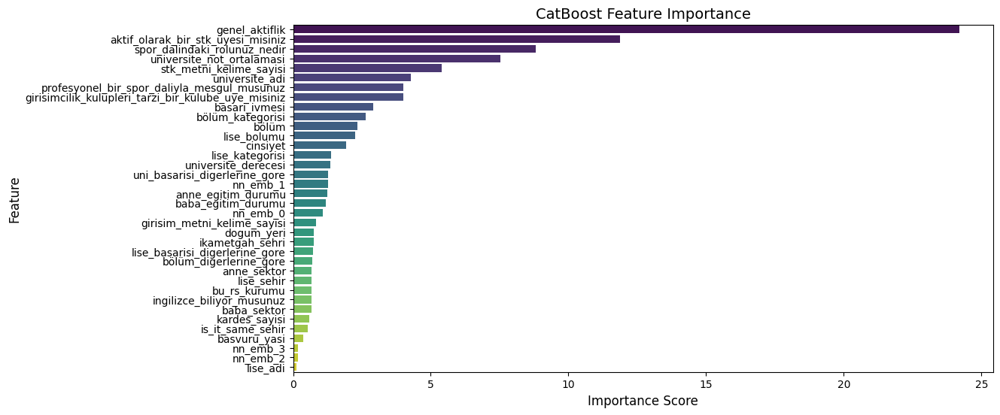

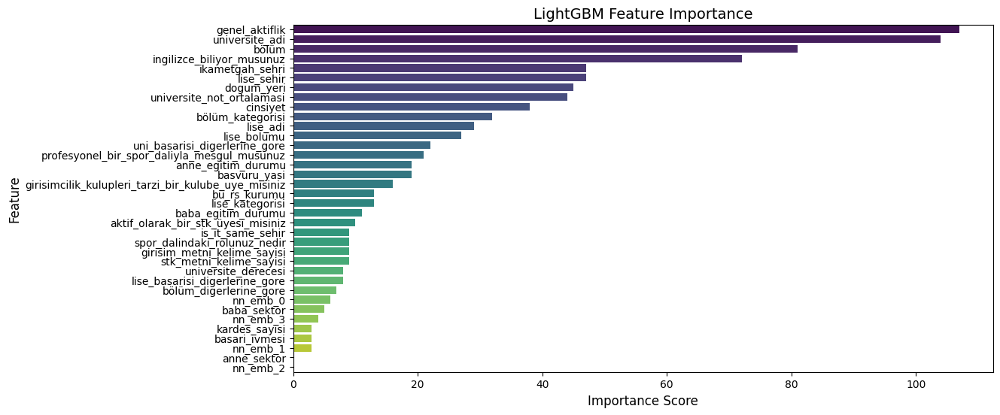

In [179]:
#get feature importances
cat_fi = final_cat.get_feature_importance(prettified=False)
lgb_fi = final_lgb.feature_importances_

# Create DataFrame for Feature Importances
cat_importances_df = pd.DataFrame({'feature': X_model.columns, 'importance': cat_fi})
cat_importances_df = cat_importances_df.sort_values('importance', ascending=False)

lgb_importances_df = pd.DataFrame({'feature': X_model.columns, 'importance': lgb_fi})
lgb_importances_df = lgb_importances_df.sort_values('importance', ascending=False)

# ------------------------
# 5. Plot Feature Importance
# ------------------------
plt.figure(figsize=(12, 6))
sns.barplot(x=cat_importances_df["importance"], y=cat_importances_df["feature"], palette="viridis")
plt.title("CatBoost Feature Importance", fontsize=14)
plt.xlabel("Importance Score", fontsize=12)
plt.ylabel("Feature", fontsize=12)
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(x=lgb_importances_df["importance"], y=lgb_importances_df["feature"], palette="viridis")
plt.title("LightGBM Feature Importance", fontsize=14)
plt.xlabel("Importance Score", fontsize=12)
plt.ylabel("Feature", fontsize=12)
plt.show()


### Grid Search Version

In [ ]:
train_final = train_final_2.copy()
test_final = test_final_2.copy()

In [23]:
# ------------------------
# 2. Define CV and RMSE Scorer
# ------------------------
kf = KFold(n_splits=3, shuffle=True, random_state=42)

rmse_scorer = make_scorer(      
    lambda y_true, y_pred: root_mean_squared_error(y_true, y_pred),
    greater_is_better=False
)

# ------------------------
# 3. Define Hyperparameter Grids
# ------------------------
param_grid_cat = {
    'iterations': [1000],
    'depth': [6],
    'learning_rate': [ 0.02],
    'l2_leaf_reg': [1e-3],
    'subsample': [0.7],
}

param_grid_lgb = {
    'n_estimators': [ 600],
    'max_depth': [-1, 8],   
    'learning_rate': [0.01, 0.05],
    'num_leaves': [32],
}

# ------------------------
# 4. Initialize Models
# ------------------------
cat_estimator = CatBoostRegressor(verbose=0, random_state=42, cat_features=cat_features)
lgb_estimator = lgb.LGBMRegressor(random_state=42)

# ------------------------
# 5. Function to Run Grid Search
# ------------------------
def run_gridsearch(model, param_grid, X, y, cv, scorer, model_name="Model"):
    gs = GridSearchCV(
        model,
        param_grid=param_grid,
        scoring=scorer,
        cv=cv,
        n_jobs=-1,
        verbose=1,
        refit=True  # Refit on best parameters
    )
    gs.fit(X, y)
    print(f"{model_name} Best RMSE (CV): {abs(gs.best_score_):.4f}")
    print(f"{model_name} Best Params: {gs.best_params_}")
    return gs

# ------------------------
# 6. Train CatBoost and LightGBM
# ------------------------
print("\nStarting CatBoost Grid Search...")
cat_gs = run_gridsearch(
    cat_estimator, param_grid_cat, X, y, kf, rmse_scorer, model_name="CatBoost"
)

print("\nStarting LightGBM Grid Search...")
lgb_gs = run_gridsearch(
    lgb_estimator, param_grid_lgb, X, y, kf, rmse_scorer, model_name="LightGBM"
)

# ------------------------
# 7. Compare Best Models
# ------------------------
models_gs = {
    "CatBoost": cat_gs,
    "LightGBM": lgb_gs
}

best_rmse = np.inf
best_model_name = None
best_model_estimator = None

for name, gs_obj in models_gs.items():
    model_rmse = abs(gs_obj.best_score_)
    if model_rmse < best_rmse:
        best_rmse = model_rmse
        best_model_name = name
        best_model_estimator = gs_obj.best_estimator_

print(f"\n Best Model Overall: {best_model_name} with CV RMSE={best_rmse:.4f}")

# ------------------------
# 8. Feature Importances for Best Model
# ------------------------
if best_model_name == "CatBoost":
    fi = best_model_estimator.get_feature_importance(prettified=False)
elif best_model_name == "LightGBM":
    fi = best_model_estimator.feature_importances_
else:
    fi = [0] * len(X.columns)  # Default case

importances_df = pd.DataFrame({'feature': X.columns, 'importance': fi}).sort_values('importance', ascending=False)

print("\nTop 10 Feature Importances:")
print(importances_df.head(10))



Starting CatBoost Grid Search...
Fitting 3 folds for each of 1 candidates, totalling 3 fits
CatBoost Best RMSE (CV): 5.6965
CatBoost Best Params: {'depth': 6, 'iterations': 1000, 'l2_leaf_reg': 0.001, 'learning_rate': 0.02, 'subsample': 0.7}

Starting LightGBM Grid Search...
Fitting 3 folds for each of 4 candidates, totalling 12 fits
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002646 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2968
[LightGBM] [Info] Number of data points in the train set: 7621, number of used features: 42
[LightGBM] [Info] Start training from score 31.628789
LightGBM Best RMSE (CV): 5.8132
LightGBM Best Params: {'learning_rate': 0.01, 'max_depth':

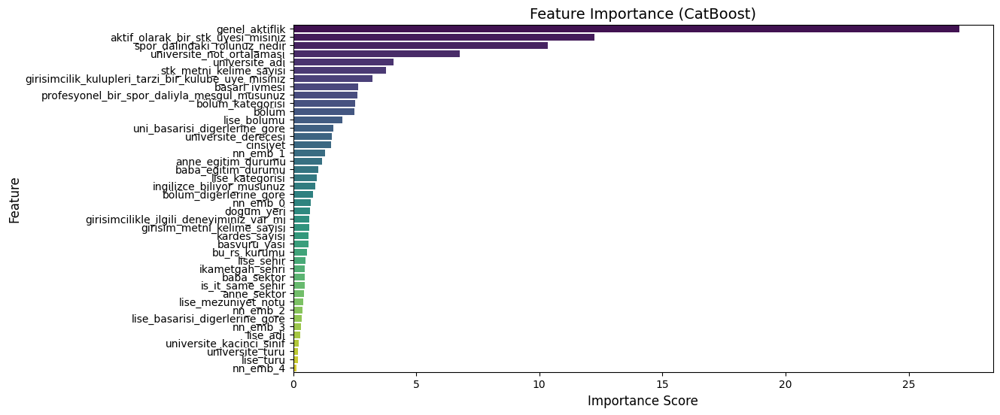

In [24]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ------------------------
# 1. Get Feature Importances from Best Model
# ------------------------
if best_model_name == "CatBoost":
    fi = best_model_estimator.get_feature_importance(prettified=False)
elif best_model_name == "LightGBM":
    fi = best_model_estimator.feature_importances_


# Create DataFrame for Feature Importances
importances_df = pd.DataFrame({'feature': X.columns, 'importance': fi})
importances_df = importances_df.sort_values('importance', ascending=False)


# ------------------------
# 3. Plot Feature Importance
# ------------------------
plt.figure(figsize=(12, 6))
sns.barplot(x=importances_df["importance"], y=importances_df["feature"], palette="viridis")
plt.title(f"Feature Importance ({best_model_name})", fontsize=14)
plt.xlabel("Importance Score", fontsize=12)
plt.ylabel("Feature", fontsize=12)
plt.show()


### No Feature Selection and Ensemble  ( BEST )

In [199]:
train_final = train_final_2.copy()
test_final = test_final_2.copy()

In [200]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_squared_error, make_scorer, root_mean_squared_error
from catboost import CatBoostRegressor
import lightgbm as lgb

# 1. Handle Categorical Features


cat_features = train_final.select_dtypes("object").columns.to_list()

# Fill missing values with 'diger'
train_final[cat_features] = train_final[cat_features].fillna("diger")
test_final[cat_features] = test_final[cat_features].fillna("diger")

# Convert categorical features to 'category' dtype for LightGBM
train_final[cat_features] = train_final[cat_features].astype("category")
test_final[cat_features] = test_final[cat_features].astype("category")

# FINAL DATA SPLITTING
X = train_final.drop("degerlendirme_puani", axis=1)
y = train_final["degerlendirme_puani"]

print("Train shape:", X.shape, "Target shape:", y.shape)
print("Test shape:", test_final.shape)



Train shape: (7621, 42) Target shape: (7621,)
Test shape: (11049, 42)


In [202]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics import mean_squared_error, make_scorer
from catboost import CatBoostRegressor
import lightgbm as lgb
from sklearn.linear_model import Ridge
from sklearn.ensemble import StackingRegressor
import optuna
import joblib
import warnings
warnings.filterwarnings("ignore")

# ------------------------------
# 0. Veri Hazırlığı
# ------------------------------
# Varsayım: X (özellikler), y (hedef değişken),
# cat_features (kategorik sütun isimleri) ve test_final (test verisi)
# daha önceden hazırlanmış durumda.
print(">>> Veri seti hazır. Özellikler:", X.columns.tolist())
print(">>> Kategorik özellikler:", cat_features)

# Bu örnekte tüm özellikler kullanılacaktır.
X_model = X.copy()  # Özellik seçimi yapılmıyor, tüm sütunlar kullanılıyor.
cat_features_model = cat_features  # Tüm kategorik sütunlar kullanılacak.

# ------------------------------
# 1. CV Stratejisi ve RMSE Skoru
# ------------------------------
print(">>> CV stratejisi ve RMSE skoru tanımlanıyor...")
cv_strategy = KFold(n_splits=3, shuffle=True, random_state=42)
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
rmse_scorer = make_scorer(rmse, greater_is_better=False)

# ------------------------------
# 2. Optuna Objective Fonksiyonları
# ------------------------------
def objective_cat(trial):
    params = {
        'iterations': trial.suggest_int("iterations", 700, 1200, step=100),
        'depth': trial.suggest_int("depth", 3, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.005, 0.02),
        'l2_leaf_reg': trial.suggest_loguniform("l2_leaf_reg", 1e-3, 10),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_seed': 42,
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        model = CatBoostRegressor(**params, cat_features=cat_features_model)
        model.fit(X_train, y_train, eval_set=(X_valid, y_valid))
        preds = model.predict(X_valid)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))

    #    if trial.should_prune():                                                # Optuna'nın trial'ı durdurup durdurmayacağını kontrol et (early stopping) 
    #        raise optuna.exceptions.TrialPruned()
        
    mean_score = np.mean(cv_scores)
    print(f"CatBoost denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

def objective_lgb(trial):
    params = {
        'n_estimators': trial.suggest_int("n_estimators", 700, 1200, step=100),
        'max_depth': trial.suggest_int("max_depth", -1, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.005, 0.1),
        'num_leaves': trial.suggest_int("num_leaves", 10, 100),
        'min_child_samples': trial.suggest_int("min_child_samples", 5, 50),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_state': 42
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        model = lgb.LGBMRegressor(**params)
        model.fit(X_train, y_train, eval_set=[(X_valid, y_valid)])
        preds = model.predict(X_valid)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))
        #if trial.should_prune():
        #    raise optuna.exceptions.TrialPruned()
    mean_score = np.mean(cv_scores)
    print(f"LightGBM denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

# ------------------------------       
# 3. Hiperparametre Optimizasyonu                           
# ------------------------------
print(">>> Optuna ile CatBoost hiperparametre optimizasyonu başlıyor...")
study_cat = optuna.create_study(direction="minimize")
study_cat.optimize(objective_cat, n_trials=100, timeout=200)
print("CatBoost - En İyi RMSE: {:.4f}".format(study_cat.best_value))
print("CatBoost - En İyi Parametreler:", study_cat.best_params)

print(">>> Optuna ile LightGBM hiperparametre optimizasyonu başlıyor...")
study_lgb = optuna.create_study(direction="minimize")
study_lgb.optimize(objective_lgb, n_trials=100, timeout=200)
print("LightGBM - En İyi RMSE: {:.4f}".format(study_lgb.best_value))
print("LightGBM - En İyi Parametreler:", study_lgb.best_params)

# ------------------------------
# 4. Nihai Model Eğitimi (Tüm Eğitim Verisi Üzerinde)
# ------------------------------
print(">>> Nihai model eğitimi başlıyor...")

# CatBoost için
best_cat_params = study_cat.best_params.copy()
best_cat_params.update({'random_seed': 42, })
final_cat = CatBoostRegressor(**best_cat_params, cat_features=cat_features_model)
final_cat.fit(X_model, y)
joblib.dump(final_cat, "final_catboost_model.pkl")
print("CatBoost modeli eğitim tamamlandı ve kaydedildi: final_catboost_model.pkl")

# LightGBM için
best_lgb_params = study_lgb.best_params.copy()
best_lgb_params.update({'random_state': 42})
final_lgb = lgb.LGBMRegressor(**best_lgb_params)
final_lgb.fit(X_model, y, eval_set=[(X_model, y)])
joblib.dump(final_lgb, "final_lightgbm_model.pkl")
print("LightGBM modeli eğitim tamamlandı ve kaydedildi: final_lightgbm_model.pkl")

[I 2025-02-05 16:03:21,120] A new study created in memory with name: no-name-2b002332-3cc0-4e8a-8573-7c84d3cbd105


>>> Veri seti hazır. Özellikler: ['cinsiyet', 'dogum_yeri', 'ikametgah_sehri', 'universite_adi', 'universite_turu', 'bölüm', 'universite_kacinci_sinif', 'universite_not_ortalamasi', 'lise_adi', 'lise_sehir', 'lise_turu', 'lise_bolumu', 'lise_mezuniyet_notu', 'anne_egitim_durumu', 'anne_sektor', 'baba_egitim_durumu', 'baba_sektor', 'kardes_sayisi', 'girisimcilik_kulupleri_tarzi_bir_kulube_uye_misiniz', 'profesyonel_bir_spor_daliyla_mesgul_musunuz', 'spor_dalindaki_rolunuz_nedir', 'aktif_olarak_bir_stk_üyesi_misiniz', 'girisimcilikle_ilgili_deneyiminiz_var_mi', 'ingilizce_biliyor_musunuz', 'bu_rs_kurumu', 'basvuru_yasi', 'genel_aktiflik', 'lise_kategorisi', 'bölüm_kategorisi', 'universite_derecesi', 'is_it_same_sehir', 'girisim_metni_kelime_sayisi', 'stk_metni_kelime_sayisi', 'uni_basarisi_digerlerine_gore', 'lise_basarisi_digerlerine_gore', 'bölüm_digerlerine_gore', 'basari_ivmesi', 'nn_emb_0', 'nn_emb_1', 'nn_emb_2', 'nn_emb_3', 'nn_emb_4']
>>> Kategorik özellikler: ['cinsiyet', 'dogum

[I 2025-02-05 16:03:21,705] Trial 0 finished with value: 7.062848120365992 and parameters: {'n_estimators': 800, 'max_depth': 1, 'learning_rate': 0.005323685225076035, 'num_leaves': 68, 'min_child_samples': 30, 'subsample': 0.8008990185304905}. Best is trial 0 with value: 7.062848120365992.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:03:23,364] Trial 1 finished with value: 5.783235849072223 and parameters: {'n_estimators': 1100, 'max_depth': 3, 'learning_rate': 0.018818290191286658, 'num_leaves': 76, 'min_child_samples': 23, 'subsample': 0.5218182454554628}. Best is trial 1 with value: 5.783235849072223.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:03:29,321] Trial 2 finished with value: 5.835587454584267 and parameters: {'n_estimators': 900, 'max_depth': 7, 'learning_rate': 0.008451967340547085, 'num_leaves': 99, 'min_child_samples': 37, 'subsample': 0.9871895099468542}. Best is trial 1 with value: 5.783235849072223.


LightGBM denemesi tamamlandı, RMSE: 5.8356
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001297 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000911 seconds.
You can set `force_row_wise=true` to remove the o

[I 2025-02-05 16:03:36,226] Trial 3 finished with value: 5.976932567350199 and parameters: {'n_estimators': 700, 'max_depth': -1, 'learning_rate': 0.06528648389218816, 'num_leaves': 57, 'min_child_samples': 19, 'subsample': 0.9321350672426509}. Best is trial 1 with value: 5.783235849072223.


LightGBM denemesi tamamlandı, RMSE: 5.9769
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001504 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001297 seconds.
You can set `force_col_wise=true` to remove the o

[I 2025-02-05 16:03:40,629] Trial 4 finished with value: 5.988165991421891 and parameters: {'n_estimators': 900, 'max_depth': 9, 'learning_rate': 0.0590292329315071, 'num_leaves': 15, 'min_child_samples': 26, 'subsample': 0.8314228943879252}. Best is trial 1 with value: 5.783235849072223.


LightGBM denemesi tamamlandı, RMSE: 5.9882
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001548 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:03:50,394] Trial 5 finished with value: 5.872835682840976 and parameters: {'n_estimators': 800, 'max_depth': 10, 'learning_rate': 0.008673092618236565, 'num_leaves': 95, 'min_child_samples': 17, 'subsample': 0.8361075784572468}. Best is trial 1 with value: 5.783235849072223.


LightGBM denemesi tamamlandı, RMSE: 5.8728
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000600 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:03:51,290] Trial 6 finished with value: 5.841379328142133 and parameters: {'n_estimators': 700, 'max_depth': 3, 'learning_rate': 0.009198494263717522, 'num_leaves': 45, 'min_child_samples': 10, 'subsample': 0.8520728978460078}. Best is trial 1 with value: 5.783235849072223.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:04:01,717] Trial 7 finished with value: 5.854649944623147 and parameters: {'n_estimators': 900, 'max_depth': -1, 'learning_rate': 0.0052319748869472235, 'num_leaves': 88, 'min_child_samples': 37, 'subsample': 0.546164509166293}. Best is trial 1 with value: 5.783235849072223.


LightGBM denemesi tamamlandı, RMSE: 5.8546
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001419 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:02,886] Trial 8 finished with value: 5.74449942203352 and parameters: {'n_estimators': 1200, 'max_depth': 1, 'learning_rate': 0.027250273666872413, 'num_leaves': 94, 'min_child_samples': 47, 'subsample': 0.7241909662698937}. Best is trial 8 with value: 5.74449942203352.


LightGBM denemesi tamamlandı, RMSE: 5.7445
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000649 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:03,769] Trial 9 finished with value: 5.746379141116974 and parameters: {'n_estimators': 1000, 'max_depth': 2, 'learning_rate': 0.01626008576450679, 'num_leaves': 54, 'min_child_samples': 28, 'subsample': 0.9080454851034256}. Best is trial 8 with value: 5.74449942203352.


LightGBM denemesi tamamlandı, RMSE: 5.7464
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000761 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:09,755] Trial 10 finished with value: 6.003210044654334 and parameters: {'n_estimators': 1200, 'max_depth': 6, 'learning_rate': 0.04254662757808158, 'num_leaves': 26, 'min_child_samples': 49, 'subsample': 0.6771610498517153}. Best is trial 8 with value: 5.74449942203352.


LightGBM denemesi tamamlandı, RMSE: 6.0032
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001253 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:11,948] Trial 11 finished with value: 5.737637868613393 and parameters: {'n_estimators': 1100, 'max_depth': 2, 'learning_rate': 0.024025402447863175, 'num_leaves': 41, 'min_child_samples': 48, 'subsample': 0.6769735804808277}. Best is trial 11 with value: 5.737637868613393.


LightGBM denemesi tamamlandı, RMSE: 5.7376
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001556 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:13,196] Trial 12 finished with value: 5.7329282967340065 and parameters: {'n_estimators': 1200, 'max_depth': 1, 'learning_rate': 0.03146693974835233, 'num_leaves': 35, 'min_child_samples': 48, 'subsample': 0.6798534604471783}. Best is trial 12 with value: 5.7329282967340065.


LightGBM denemesi tamamlandı, RMSE: 5.7329
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000631 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:18,110] Trial 13 finished with value: 5.916760165312742 and parameters: {'n_estimators': 1100, 'max_depth': 5, 'learning_rate': 0.031249413984308288, 'num_leaves': 34, 'min_child_samples': 41, 'subsample': 0.6151285050943387}. Best is trial 12 with value: 5.7329282967340065.


LightGBM denemesi tamamlandı, RMSE: 5.9168
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001726 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:19,715] Trial 14 finished with value: 5.731195217288914 and parameters: {'n_estimators': 1100, 'max_depth': 1, 'learning_rate': 0.09741150114864275, 'num_leaves': 37, 'min_child_samples': 43, 'subsample': 0.6369976298301965}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 5.7312
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001764 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001289 seconds.
You can set `force_col_wise=true` to remove the o

[I 2025-02-05 16:04:25,580] Trial 15 finished with value: 6.136702943240434 and parameters: {'n_estimators': 1200, 'max_depth': -1, 'learning_rate': 0.09931383606484724, 'num_leaves': 16, 'min_child_samples': 43, 'subsample': 0.5954368799226937}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 6.1367
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001499 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:28,339] Trial 16 finished with value: 6.070882874481986 and parameters: {'n_estimators': 1000, 'max_depth': 4, 'learning_rate': 0.09215621316361533, 'num_leaves': 27, 'min_child_samples': 34, 'subsample': 0.7180054736784477}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 6.0709
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001579 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001496 seconds.
You can set `force_col_wise=true` to remove the o

[I 2025-02-05 16:04:39,121] Trial 17 finished with value: 5.986496757645674 and parameters: {'n_estimators': 1100, 'max_depth': 0, 'learning_rate': 0.04075600901165972, 'num_leaves': 50, 'min_child_samples': 43, 'subsample': 0.633077946210315}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 5.9865
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001430 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:40,520] Trial 18 finished with value: 5.859683723656578 and parameters: {'n_estimators': 1200, 'max_depth': 1, 'learning_rate': 0.014919344347461424, 'num_leaves': 35, 'min_child_samples': 33, 'subsample': 0.7567513561764754}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 5.8597
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000805 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:43,752] Trial 19 finished with value: 6.00919484803907 and parameters: {'n_estimators': 1000, 'max_depth': 4, 'learning_rate': 0.06363008495514769, 'num_leaves': 60, 'min_child_samples': 5, 'subsample': 0.5714885178333462}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 6.0092
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003958 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.0

[I 2025-02-05 16:04:47,150] Trial 20 finished with value: 5.8852017850679035 and parameters: {'n_estimators': 1100, 'max_depth': 8, 'learning_rate': 0.03470446495216046, 'num_leaves': 10, 'min_child_samples': 40, 'subsample': 0.6650192081239052}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 5.8852
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001702 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:49,339] Trial 21 finished with value: 5.732278613287655 and parameters: {'n_estimators': 1100, 'max_depth': 2, 'learning_rate': 0.02390632060190623, 'num_leaves': 41, 'min_child_samples': 50, 'subsample': 0.6750800144838992}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 5.7323
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001282 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:04:51,749] Trial 22 finished with value: 5.753639670795458 and parameters: {'n_estimators': 1200, 'max_depth': 2, 'learning_rate': 0.012662968738936863, 'num_leaves': 26, 'min_child_samples': 45, 'subsample': 0.6427046670995563}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 5.7536
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001702 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001525 seconds.
You can set `force_col_wise=true` to remove the o

[I 2025-02-05 16:04:59,690] Trial 23 finished with value: 5.991057031011696 and parameters: {'n_estimators': 1100, 'max_depth': 0, 'learning_rate': 0.049155047234489976, 'num_leaves': 38, 'min_child_samples': 50, 'subsample': 0.7759885441249496}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 5.9911
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:05:01,293] Trial 24 finished with value: 5.792974707894634 and parameters: {'n_estimators': 1000, 'max_depth': 3, 'learning_rate': 0.022297616415596307, 'num_leaves': 47, 'min_child_samples': 39, 'subsample': 0.708146849094435}. Best is trial 14 with value: 5.731195217288914.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:05:08,992] Trial 25 finished with value: 6.069769026078198 and parameters: {'n_estimators': 1200, 'max_depth': 0, 'learning_rate': 0.07460062153213788, 'num_leaves': 29, 'min_child_samples': 45, 'subsample': 0.5845426805365163}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 6.0698
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001648 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:05:14,522] Trial 26 finished with value: 5.830325014677165 and parameters: {'n_estimators': 1100, 'max_depth': 5, 'learning_rate': 0.012084846188884016, 'num_leaves': 62, 'min_child_samples': 50, 'subsample': 0.5112719148320977}. Best is trial 14 with value: 5.731195217288914.


LightGBM denemesi tamamlandı, RMSE: 5.8303
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000854 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:05:15,291] Trial 27 finished with value: 5.822061065088242 and parameters: {'n_estimators': 1000, 'max_depth': 1, 'learning_rate': 0.020474209909080564, 'num_leaves': 43, 'min_child_samples': 45, 'subsample': 0.6942164000060013}. Best is trial 14 with value: 5.731195217288914.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:05:18,082] Trial 28 finished with value: 5.748692699092561 and parameters: {'n_estimators': 1200, 'max_depth': 2, 'learning_rate': 0.030404951000564034, 'num_leaves': 21, 'min_child_samples': 34, 'subsample': 0.6451823289466426}. Best is trial 14 with value: 5.731195217288914.


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001529 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 16:05:19,670] Trial 29 finished with value: 5.727719513854107 and parameters: {'n_estimators': 1100, 'max_depth': 1, 'learning_rate': 0.03836285197192129, 'num_leaves': 71, 'min_child_samples': 31, 'subsample': 0.7694327454000722}. Best is trial 29 with value: 5.727719513854107.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:05:30,665] Trial 30 finished with value: 5.958441502775958 and parameters: {'n_estimators': 1000, 'max_depth': 0, 'learning_rate': 0.04662502481160814, 'num_leaves': 68, 'min_child_samples': 25, 'subsample': 0.782110055273618}. Best is trial 29 with value: 5.727719513854107.


LightGBM denemesi tamamlandı, RMSE: 5.9584
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001546 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:05:32,281] Trial 31 finished with value: 5.732605729732843 and parameters: {'n_estimators': 1100, 'max_depth': 1, 'learning_rate': 0.0346609331032844, 'num_leaves': 71, 'min_child_samples': 32, 'subsample': 0.7534683396919942}. Best is trial 29 with value: 5.727719513854107.


LightGBM denemesi tamamlandı, RMSE: 5.7326
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001285 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:05:34,942] Trial 32 finished with value: 5.849507916367336 and parameters: {'n_estimators': 1100, 'max_depth': 3, 'learning_rate': 0.039705642442399686, 'num_leaves': 78, 'min_child_samples': 30, 'subsample': 0.751475792006621}. Best is trial 29 with value: 5.727719513854107.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:05:36,246] Trial 33 finished with value: 5.765661303887083 and parameters: {'n_estimators': 1100, 'max_depth': 1, 'learning_rate': 0.024772574067855734, 'num_leaves': 69, 'min_child_samples': 21, 'subsample': 0.8048902941218402}. Best is trial 29 with value: 5.727719513854107.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:05:38,261] Trial 34 finished with value: 5.7819613412815665 and parameters: {'n_estimators': 1100, 'max_depth': 2, 'learning_rate': 0.051888523896361095, 'num_leaves': 79, 'min_child_samples': 31, 'subsample': 0.7304177443777853}. Best is trial 29 with value: 5.727719513854107.


LightGBM denemesi tamamlandı, RMSE: 5.7820
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001793 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:05:40,428] Trial 35 finished with value: 5.947869639103271 and parameters: {'n_estimators': 900, 'max_depth': 3, 'learning_rate': 0.07413673667798758, 'num_leaves': 70, 'min_child_samples': 37, 'subsample': 0.8871015237136112}. Best is trial 29 with value: 5.727719513854107.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:05:49,989] Trial 36 finished with value: 5.890920543846552 and parameters: {'n_estimators': 1000, 'max_depth': 0, 'learning_rate': 0.019139218599112662, 'num_leaves': 53, 'min_child_samples': 17, 'subsample': 0.9992493712685875}. Best is trial 29 with value: 5.727719513854107.


LightGBM denemesi tamamlandı, RMSE: 5.8909
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002101 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001321 seconds.
You can set `force_col_wise=true` to remove the o

[I 2025-02-05 16:06:00,569] Trial 37 finished with value: 5.877866065662373 and parameters: {'n_estimators': 800, 'max_depth': -1, 'learning_rate': 0.01714871923124476, 'num_leaves': 84, 'min_child_samples': 24, 'subsample': 0.8036023306305338}. Best is trial 29 with value: 5.727719513854107.


LightGBM denemesi tamamlandı, RMSE: 5.8779
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001564 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:06:02,322] Trial 38 finished with value: 5.792075969070024 and parameters: {'n_estimators': 1100, 'max_depth': 2, 'learning_rate': 0.056267308860181844, 'num_leaves': 64, 'min_child_samples': 27, 'subsample': 0.8342236742724343}. Best is trial 29 with value: 5.727719513854107.


LightGBM denemesi tamamlandı, RMSE: 5.7921
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001197 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:06:06,983] Trial 39 finished with value: 5.820894902937638 and parameters: {'n_estimators': 1100, 'max_depth': 4, 'learning_rate': 0.006428021786853137, 'num_leaves': 73, 'min_child_samples': 13, 'subsample': 0.5482679829668662}. Best is trial 29 with value: 5.727719513854107.


LightGBM denemesi tamamlandı, RMSE: 5.8209
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001579 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001868 seconds.
You can set `force_col_wise=true` to remove the o

[I 2025-02-05 16:06:19,477] Trial 40 finished with value: 6.027040921574766 and parameters: {'n_estimators': 900, 'max_depth': -1, 'learning_rate': 0.0769064105438224, 'num_leaves': 84, 'min_child_samples': 36, 'subsample': 0.739407805211425}. Best is trial 29 with value: 5.727719513854107.


LightGBM denemesi tamamlandı, RMSE: 6.0270
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000721 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:06:21,329] Trial 41 finished with value: 5.72837002721942 and parameters: {'n_estimators': 1200, 'max_depth': 1, 'learning_rate': 0.03432354737735298, 'num_leaves': 32, 'min_child_samples': 47, 'subsample': 0.6135513362286164}. Best is trial 29 with value: 5.727719513854107.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:06:22,880] Trial 42 finished with value: 5.727184586531512 and parameters: {'n_estimators': 1200, 'max_depth': 1, 'learning_rate': 0.035165334413994484, 'num_leaves': 57, 'min_child_samples': 42, 'subsample': 0.6161555150534656}. Best is trial 42 with value: 5.727184586531512.


LightGBM denemesi tamamlandı, RMSE: 5.7272
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001754 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001533 seconds.
You can set `force_col_wise=true` to remove the o

[I 2025-02-05 16:06:34,021] Trial 43 finished with value: 5.974960117481035 and parameters: {'n_estimators': 1200, 'max_depth': 0, 'learning_rate': 0.036611584012877355, 'num_leaves': 49, 'min_child_samples': 42, 'subsample': 0.6154003384548135}. Best is trial 42 with value: 5.727184586531512.


LightGBM denemesi tamamlandı, RMSE: 5.9750
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002295 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:06:37,804] Trial 44 finished with value: 5.817298249704056 and parameters: {'n_estimators': 1200, 'max_depth': 3, 'learning_rate': 0.026128342249667116, 'num_leaves': 56, 'min_child_samples': 47, 'subsample': 0.5408144744590173}. Best is trial 42 with value: 5.727184586531512.


LightGBM denemesi tamamlandı, RMSE: 5.8173
[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001598 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[I 2025-02-05 16:06:39,223] Trial 45 finished with value: 5.720557400364744 and parameters: {'n_estimators': 1200, 'max_depth': 1, 'learning_rate': 0.04530871568539533, 'num_leaves': 31, 'min_child_samples': 45, 'subsample': 0.6087365090112407}. Best is trial 45 with value: 5.720557400364744.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 16:06:40,750] Trial 46 finished with value: 5.720151755022106 and parameters: {'n_estimators': 1200, 'max_depth': 1, 'learning_rate': 0.04514466541063014, 'num_leaves': 19, 'min_child_samples': 39, 'subsample': 0.563755972143267}. Best is trial 46 with value: 5.720151755022106.


[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2647
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 42
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-02-05 16:06:42,134] Trial 47 finished with value: 5.72193785587086 and parameters: {'n_estimators': 1200, 'max_depth': 1, 'learning_rate': 0.043148560786979616, 'num_leaves': 19, 'min_child_samples': 39, 'subsample': 0.52969247466387}. Best is trial 46 with value: 5.720151755022106.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

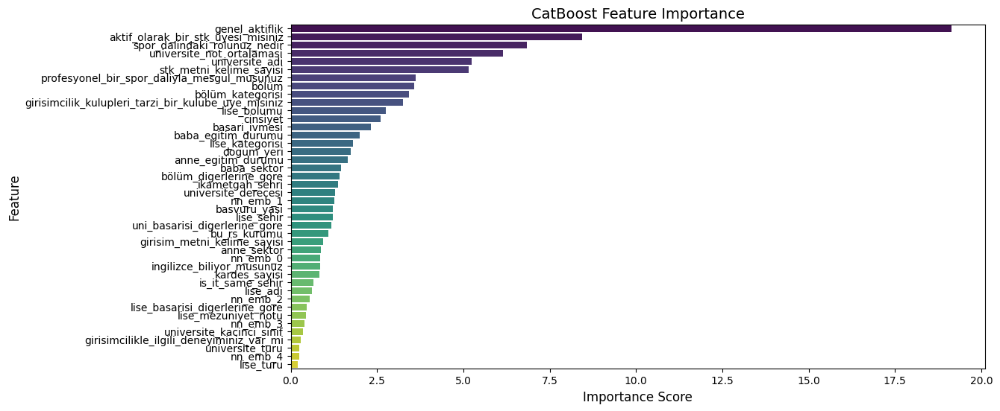

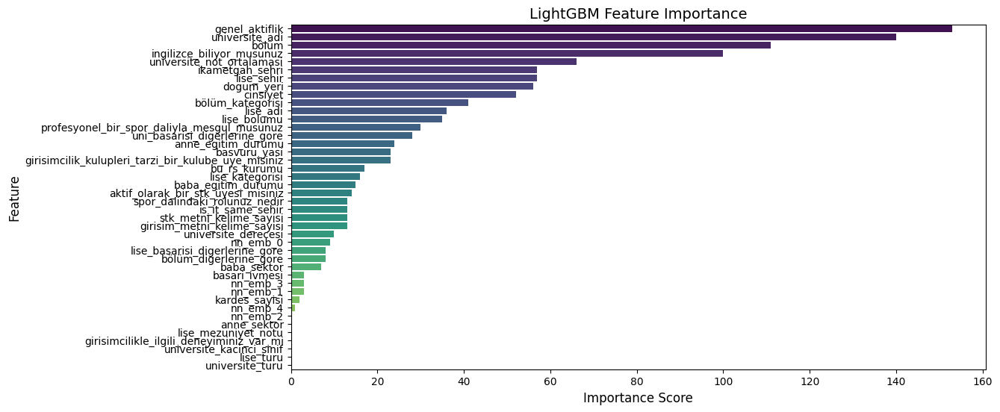

In [203]:
#get feature importances
cat_fi = final_cat.get_feature_importance(prettified=False)
lgb_fi = final_lgb.feature_importances_

# Create DataFrame for Feature Importances
cat_importances_df = pd.DataFrame({'feature': X_model.columns, 'importance': cat_fi})
cat_importances_df = cat_importances_df.sort_values('importance', ascending=False)

lgb_importances_df = pd.DataFrame({'feature': X_model.columns, 'importance': lgb_fi})
lgb_importances_df = lgb_importances_df.sort_values('importance', ascending=False)

# ------------------------
# 5. Plot Feature Importance
# ------------------------
plt.figure(figsize=(12, 6))
sns.barplot(x=cat_importances_df["importance"], y=cat_importances_df["feature"], palette="viridis")
plt.title("CatBoost Feature Importance", fontsize=14)
plt.xlabel("Importance Score", fontsize=12)
plt.ylabel("Feature", fontsize=12)
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(x=lgb_importances_df["importance"], y=lgb_importances_df["feature"], palette="viridis")
plt.title("LightGBM Feature Importance", fontsize=14)
plt.xlabel("Importance Score", fontsize=12)
plt.ylabel("Feature", fontsize=12)
plt.show()


In [204]:
from sklearn.ensemble import VotingRegressor

print(">>> Voting Regressor modeli oluşturuluyor...")


voting_model = VotingRegressor(estimators=[('catboost', final_cat), ('lightgbm', final_lgb)])
voting_model.fit(X_model, y)


joblib.dump(voting_model, "final_voting_model.pkl")
print("Voting Regressor modeli eğitim tamamlandı ve kaydedildi: final_voting_model.pkl")

>>> Voting Regressor modeli oluşturuluyor...
0:	learn: 14.3874925	total: 75.5ms	remaining: 1m 30s
1:	learn: 14.1897668	total: 142ms	remaining: 1m 24s
2:	learn: 13.9949079	total: 211ms	remaining: 1m 24s
3:	learn: 13.8112416	total: 281ms	remaining: 1m 23s
4:	learn: 13.6334978	total: 347ms	remaining: 1m 22s
5:	learn: 13.4655010	total: 411ms	remaining: 1m 21s
6:	learn: 13.2984044	total: 479ms	remaining: 1m 21s
7:	learn: 13.1192510	total: 540ms	remaining: 1m 20s
8:	learn: 12.9570398	total: 616ms	remaining: 1m 21s
9:	learn: 12.8029506	total: 687ms	remaining: 1m 21s
10:	learn: 12.6438002	total: 752ms	remaining: 1m 21s
11:	learn: 12.4866719	total: 824ms	remaining: 1m 21s
12:	learn: 12.3364001	total: 889ms	remaining: 1m 21s
13:	learn: 12.1871984	total: 964ms	remaining: 1m 21s
14:	learn: 12.0414441	total: 1.03s	remaining: 1m 21s
15:	learn: 11.9029431	total: 1.1s	remaining: 1m 21s
16:	learn: 11.7624984	total: 1.17s	remaining: 1m 21s
17:	learn: 11.6269099	total: 1.24s	remaining: 1m 21s
18:	learn: 

In [205]:
print(">>> Voting Regressor için CV RMSE skoru hesaplanıyor...")

voting_cv_scores = cross_val_score(voting_model, X_model, y, scoring=rmse_scorer, cv=cv_strategy, n_jobs=-1)
mean_voting_rmse = abs(np.mean(voting_cv_scores))

print("Voting Regressor Ensemble - Mean CV RMSE: {:.4f}".format(mean_voting_rmse))

>>> Voting Regressor için CV RMSE skoru hesaplanıyor...
Voting Regressor Ensemble - Mean CV RMSE: 5.6399


In [206]:
# drop 'Degerlendirme Puani', 'id'

test_final = test_final.drop(['Degerlendirme Puani', 'id'], axis=1)

KeyError: "['Degerlendirme Puani', 'id'] not found in axis"

In [207]:
# use the model to make predictions for submission
test_preds = voting_model.predict(test_final)

# Add predictions to DataFrame with a consistent column name
test_final["Degerlendirme Puani"] = test_preds

# Create 'id' column as row number (starting from 0 or 1)

test_final = test_final.reset_index(drop=True)  # Reset index

test_final["id"] = test_final.index  # Start IDs from 0, use `index + 1` to start from 1

# Select only 'id' and 'degerlendirme_puani' for submission

submission = test_final[["id", "Degerlendirme Puani"]]

# Save submission

submission.to_csv("submission.csv", index=False)

# Display the first few rows
print(submission.head())

   id  Degerlendirme Puani
0   0            32.963111
1   1            21.021373
2   2             8.011064
3   3            17.628607
4   4            41.638895


### Catboost with SHAP

In [180]:
train_final = train_final_2.copy()
test_final = test_final_2.copy()

In [181]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_squared_error, make_scorer, root_mean_squared_error
from catboost import CatBoostRegressor
import lightgbm as lgb

# 1. Handle Categorical Features

cat_features = train_final.select_dtypes("object").columns.to_list()

# Fill missing values with 'diger'
train_final[cat_features] = train_final[cat_features].fillna("diger")
test_final[cat_features] = test_final[cat_features].fillna("diger")

# Convert categorical features to 'category' dtype for LightGBM
train_final[cat_features] = train_final[cat_features].astype("category")
test_final[cat_features] = test_final[cat_features].astype("category")

# FINAL DATA SPLITTING
X = train_final.drop("degerlendirme_puani", axis=1)
y = train_final["degerlendirme_puani"]

print("Train shape:", X.shape, "Target shape:", y.shape)
print("Test shape:", test_final.shape)



Train shape: (7621, 42) Target shape: (7621,)
Test shape: (11049, 42)


In [182]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, make_scorer
from catboost import CatBoostRegressor, Pool, EFeaturesSelectionAlgorithm, EShapCalcType
import lightgbm as lgb
import optuna
import joblib
import warnings
warnings.filterwarnings("ignore")

# ------------------------------
# 0. Veri Hazırlığı
# ------------------------------
# Assumes X (features), y (target), cat_features (categorical column names) and test_final are defined.
print(">>> Veri seti hazır. Özellikler:", X.columns.tolist())
print(">>> Kategorik özellikler:", cat_features)
X_model = X.copy()  # All features initially
cat_features_model = cat_features

# ------------------------------
# 1. CV Stratejisi ve RMSE Skoru
# ------------------------------
print(">>> CV stratejisi ve RMSE skoru tanımlanıyor...")
cv_strategy = KFold(n_splits=3, shuffle=True, random_state=42)
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
rmse_scorer = make_scorer(rmse, greater_is_better=False)

# ------------------------------
# Helper: CatBoost Feature Selection using select_features
# ------------------------------
def perform_catboost_fs(X_train, y_train, X_valid,y_valid):
    # Create Pools with categorical features
    train_pool = Pool(X_train, y_train, cat_features=cat_features_model)
    valid_pool = Pool(X_valid, y_valid, cat_features=cat_features_model)
    # Build a lightweight model for feature selection
    fs_model = CatBoostRegressor(iterations=200, depth=3, learning_rate=0.1,
                                 random_seed=42, verbose=0)
    # Specify features for selection using indices (all features).
    features_str = "0-{}".format(X_train.shape[1] - 1)
    # Set the number of features to select (example: half the features)
    num_fs = int(35)
    # Run CatBoost select_features
    select_res = fs_model.select_features(
        train_pool,
        eval_set=valid_pool,
        features_for_select=features_str,
        num_features_to_select=num_fs,
        steps=3,
        algorithm=EFeaturesSelectionAlgorithm.RecursiveByShapValues,
        shap_calc_type=EShapCalcType.Regular,
        train_final_model=False,
        plot=False
    )
    # select_res is a dict; get indices of selected features.
    sel_indices = select_res['selected_features']  # indices of features selected
    # Get selected features names
    sel_feature_names = list(X_train.columns[sel_indices])
    # Subset data accordingly.
    X_train_sel = X_train.iloc[:, sel_indices].copy()
    X_valid_sel = X_valid.iloc[:, sel_indices].copy()
    # Update categorical features: use names that are in both the selected features and cat_features_model.
    cat_features_sel = [col for col in sel_feature_names if col in cat_features_model]
    return X_train_sel, X_valid_sel, cat_features_sel

# ------------------------------
# 2. Optuna Objective Fonksiyonları with CatBoost Feature Selection
# ------------------------------
def objective_cat(trial):
    params = {
        'iterations': trial.suggest_int("iterations", 700, 1200, step=100),
        'depth': trial.suggest_int("depth", 3, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.005, 0.02),
        'l2_leaf_reg': trial.suggest_loguniform("l2_leaf_reg", 1e-3, 10),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_seed': 42,
        "verbose": 0
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        # Apply CatBoost feature selection in this fold.
        X_train_sel, X_valid_sel, cat_features_sel = perform_catboost_fs(X_train, y_train, X_valid,y_valid)
        model = CatBoostRegressor(**params, cat_features=cat_features_sel)
        model.fit(X_train_sel, y_train, eval_set=(X_valid_sel, y_valid))
        preds = model.predict(X_valid_sel)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()
    mean_score = np.mean(cv_scores)
    print(f"CatBoost denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

def objective_lgb(trial):
    params = {
        'n_estimators': trial.suggest_int("n_estimators", 700, 1200, step=100),
        'max_depth': trial.suggest_int("max_depth", -1, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.005, 0.1),
        'num_leaves': trial.suggest_int("num_leaves", 10, 100),
        'min_child_samples': trial.suggest_int("min_child_samples", 5, 50),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_state': 42
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        # Use CatBoost FS before training LightGBM.
        X_train_sel, X_valid_sel, _ = perform_catboost_fs(X_train, y_train, X_valid,y_valid)
        model = lgb.LGBMRegressor(**params)
        model.fit(X_train_sel, y_train, eval_set=[(X_valid_sel, y_valid)])
        preds = model.predict(X_valid_sel)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()
    mean_score = np.mean(cv_scores)
    print(f"LightGBM denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

# ------------------------------
# 3. Hiperparametre Optimizasyonu
# ------------------------------
print(">>> Optuna ile CatBoost hiperparametre optimizasyonu başlıyor...")
study_cat = optuna.create_study(direction="minimize")
study_cat.optimize(objective_cat, n_trials=100, timeout=200)
print("CatBoost - En İyi RMSE: {:.4f}".format(study_cat.best_value))
print("CatBoost - En İyi Parametreler:", study_cat.best_params)

print(">>> Optuna ile LightGBM hiperparametre optimizasyonu başlıyor...")
study_lgb = optuna.create_study(direction="minimize")
study_lgb.optimize(objective_lgb, n_trials=100, timeout=200)
print("LightGBM - En İyi RMSE: {:.4f}".format(study_lgb.best_value))
print("LightGBM - En İyi Parametreler:", study_lgb.best_params)

# ------------------------------
# 4. Nihai Model Eğitimi (Tüm Eğitim Verisi Üzerinde) with CatBoost FS
# ------------------------------
print(">>> Nihai model eğitimi başlıyor...")

# Create a Pool for full training data.
full_pool = Pool(X_model, y, cat_features=cat_features_model)
fs_model_full = CatBoostRegressor(iterations=200, depth=3, learning_rate=0.1,
                                  random_seed=42, verbose=0)
features_str_full = "0-{}".format(X_model.shape[1] - 1)
num_fs_full = int(35)  # for example, select half the features
select_res_full = fs_model_full.select_features(
    full_pool,
    features_for_select=features_str_full,
    num_features_to_select=num_fs_full,
    steps=3,
    algorithm=EFeaturesSelectionAlgorithm.RecursiveByShapValues,
    shap_calc_type=EShapCalcType.Regular,
    train_final_model=False,
    plot=False
)
sel_indices_full = select_res_full['selected_features']
selected_features = list(X_model.columns[sel_indices_full])
X_model_sel = X_model.iloc[:, sel_indices_full].copy()
cat_features_sel_final = [col for col in selected_features if col in cat_features_model]
print("Seçilen özellikler:", selected_features)

# CatBoost final model
best_cat_params = study_cat.best_params.copy()
best_cat_params.update({'random_seed': 42, 'verbose': 0})
final_cat = CatBoostRegressor(**best_cat_params, cat_features=cat_features_sel_final)
final_cat.fit(X_model_sel, y)
joblib.dump((final_cat, selected_features), "final_catboost_model.pkl")
print("CatBoost modeli eğitim tamamlandı ve kaydedildi: final_catboost_model.pkl")

# LightGBM final model
best_lgb_params = study_lgb.best_params.copy()
best_lgb_params.update({'random_state': 42})
final_lgb = lgb.LGBMRegressor(**best_lgb_params)
final_lgb.fit(X_model_sel, y, eval_set=[(X_model_sel, y)])
joblib.dump((final_lgb, selected_features), "final_lightgbm_model.pkl")
print("LightGBM modeli eğitim tamamlandı ve kaydedildi: final_lightgbm_model.pkl")


[I 2025-02-05 15:08:25,838] A new study created in memory with name: no-name-cffd44a1-e787-4d49-9728-71361cb8ee2b


>>> Veri seti hazır. Özellikler: ['cinsiyet', 'dogum_yeri', 'ikametgah_sehri', 'universite_adi', 'universite_turu', 'bölüm', 'universite_kacinci_sinif', 'universite_not_ortalamasi', 'lise_adi', 'lise_sehir', 'lise_turu', 'lise_bolumu', 'lise_mezuniyet_notu', 'anne_egitim_durumu', 'anne_sektor', 'baba_egitim_durumu', 'baba_sektor', 'kardes_sayisi', 'girisimcilik_kulupleri_tarzi_bir_kulube_uye_misiniz', 'profesyonel_bir_spor_daliyla_mesgul_musunuz', 'spor_dalindaki_rolunuz_nedir', 'aktif_olarak_bir_stk_üyesi_misiniz', 'girisimcilikle_ilgili_deneyiminiz_var_mi', 'ingilizce_biliyor_musunuz', 'bu_rs_kurumu', 'basvuru_yasi', 'genel_aktiflik', 'lise_kategorisi', 'bölüm_kategorisi', 'universite_derecesi', 'is_it_same_sehir', 'girisim_metni_kelime_sayisi', 'stk_metni_kelime_sayisi', 'uni_basarisi_digerlerine_gore', 'lise_basarisi_digerlerine_gore', 'bölüm_digerlerine_gore', 'basari_ivmesi', 'nn_emb_0', 'nn_emb_1', 'nn_emb_2', 'nn_emb_3', 'nn_emb_4']
>>> Kategorik özellikler: ['cinsiyet', 'dogum

[I 2025-02-05 15:17:47,312] Trial 0 finished with value: 5.752099535488541 and parameters: {'iterations': 1000, 'depth': 10, 'learning_rate': 0.014151192346926, 'l2_leaf_reg': 5.93408669407289, 'subsample': 0.6436101240017084}. Best is trial 0 with value: 5.752099535488541.
[I 2025-02-05 15:17:47,312] A new study created in memory with name: no-name-02922027-a811-433f-ae6c-62f106f522db


CatBoost denemesi tamamlandı, RMSE: 5.7521
CatBoost - En İyi RMSE: 5.7521
CatBoost - En İyi Parametreler: {'iterations': 1000, 'depth': 10, 'learning_rate': 0.014151192346926, 'l2_leaf_reg': 5.93408669407289, 'subsample': 0.6436101240017084}
>>> Optuna ile LightGBM hiperparametre optimizasyonu başlıyor...
Step #1 out of 3

bestTest = 5.803413458
bestIteration = 199

Feature #1 eliminated
Feature #40 eliminated
Step #2 out of 3

bestTest = 5.796529582
bestIteration = 198

Shrink model to first 199 iterations.
Feature #4 eliminated
Feature #8 eliminated
Feature #10 eliminated
Step #3 out of 3

bestTest = 5.800624392
bestIteration = 195

Shrink model to first 196 iterations.
Feature #35 eliminated
Feature #38 eliminated
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000633 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1720
[LightGBM] [Info] Number of data points in the train set: 5080, number of use

[I 2025-02-05 15:18:45,521] Trial 0 finished with value: 5.812967597131698 and parameters: {'n_estimators': 1200, 'max_depth': 3, 'learning_rate': 0.005963138623418831, 'num_leaves': 37, 'min_child_samples': 20, 'subsample': 0.5307282549956988}. Best is trial 0 with value: 5.812967597131698.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:19:40,121] Trial 1 finished with value: 5.863171786697115 and parameters: {'n_estimators': 1200, 'max_depth': 2, 'learning_rate': 0.07274972950605875, 'num_leaves': 14, 'min_child_samples': 17, 'subsample': 0.6367108499789849}. Best is trial 0 with value: 5.812967597131698.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-05 15:20:34,033] Trial 2 finished with value: 5.74570026308717 and parameters: {'n_estimators': 1100, 'max_depth': 2, 'learning_rate': 0.024390025946823077, 'num_leaves': 14, 'min_child_samples': 49, 'subsample': 0.9898133422380275}. Best is trial 2 with value: 5.74570026308717.


Step #1 out of 3

bestTest = 5.803413458
bestIteration = 199

Feature #1 eliminated
Feature #40 eliminated
Step #2 out of 3

bestTest = 5.796529582
bestIteration = 198

Shrink model to first 199 iterations.
Feature #4 eliminated
Feature #8 eliminated
Feature #10 eliminated
Step #3 out of 3

bestTest = 5.800624392
bestIteration = 195

Shrink model to first 196 iterations.
Feature #35 eliminated
Feature #38 eliminated
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000607 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1720
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 35
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-02-05 15:21:29,975] Trial 3 finished with value: 5.97698916707515 and parameters: {'n_estimators': 1000, 'max_depth': 4, 'learning_rate': 0.055727597369508865, 'num_leaves': 70, 'min_child_samples': 11, 'subsample': 0.9046213732543904}. Best is trial 2 with value: 5.74570026308717.


LightGBM - En İyi RMSE: 5.7457
LightGBM - En İyi Parametreler: {'n_estimators': 1100, 'max_depth': 2, 'learning_rate': 0.024390025946823077, 'num_leaves': 14, 'min_child_samples': 49, 'subsample': 0.9898133422380275}
>>> Nihai model eğitimi başlıyor...
Step #1 out of 3
Feature #10 eliminated
Feature #6 eliminated
Step #2 out of 3
Feature #14 eliminated
Feature #41 eliminated
Feature #35 eliminated
Step #3 out of 3
Feature #4 eliminated
Feature #37 eliminated
Seçilen özellikler: ['cinsiyet', 'dogum_yeri', 'ikametgah_sehri', 'universite_adi', 'bölüm', 'universite_not_ortalamasi', 'lise_adi', 'lise_sehir', 'lise_bolumu', 'lise_mezuniyet_notu', 'anne_egitim_durumu', 'baba_egitim_durumu', 'baba_sektor', 'kardes_sayisi', 'girisimcilik_kulupleri_tarzi_bir_kulube_uye_misiniz', 'profesyonel_bir_spor_daliyla_mesgul_musunuz', 'spor_dalindaki_rolunuz_nedir', 'aktif_olarak_bir_stk_üyesi_misiniz', 'girisimcilikle_ilgili_deneyiminiz_var_mi', 'ingilizce_biliyor_musunuz', 'bu_rs_kurumu', 'basvuru_yasi'

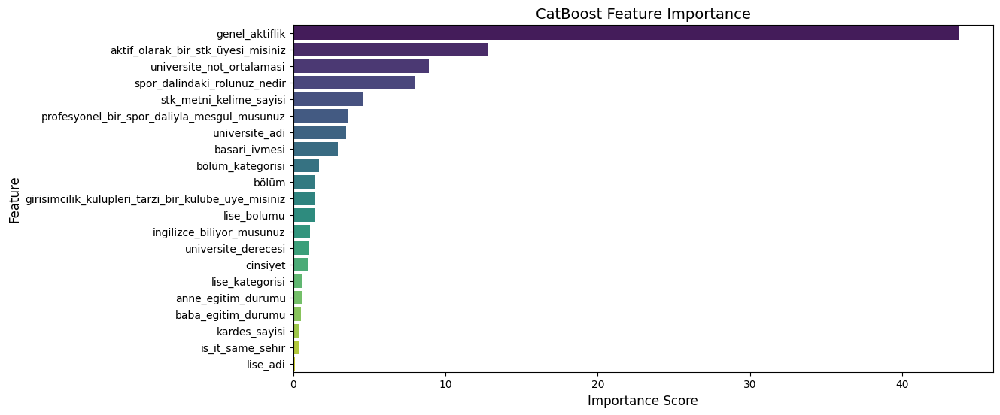

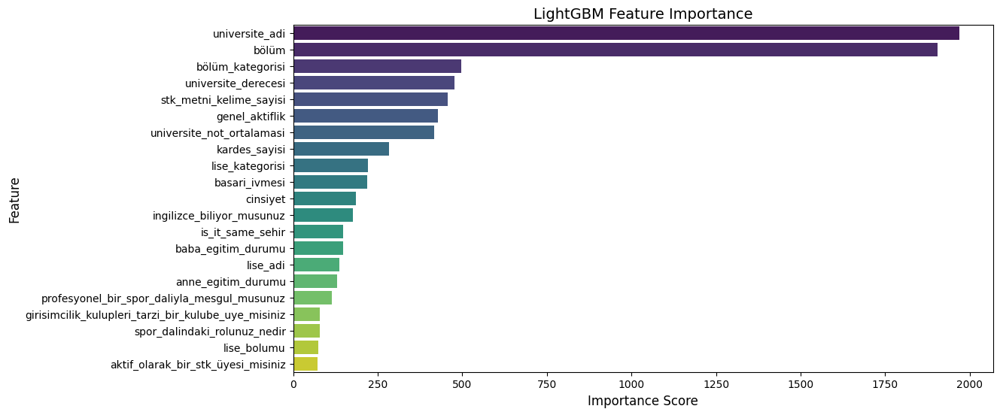

In [145]:
# featrue importance graph 
cat_fi = final_cat.get_feature_importance(prettified=False)
lgb_fi = final_lgb.feature_importances_

# Create DataFrame for Feature Importances
cat_importances_df = pd.DataFrame({'feature': X_model_sel.columns, 'importance': cat_fi})
cat_importances_df = cat_importances_df.sort_values('importance', ascending=False)

lgb_importances_df = pd.DataFrame({'feature': X_model_sel.columns, 'importance': lgb_fi})
lgb_importances_df = lgb_importances_df.sort_values('importance', ascending=False)

# ------------------------
# 5. Plot Feature Importance
# ------------------------
plt.figure(figsize=(12, 6))
sns.barplot(x=cat_importances_df["importance"], y=cat_importances_df["feature"], palette="viridis")
plt.title("CatBoost Feature Importance", fontsize=14)
plt.xlabel("Importance Score", fontsize=12)
plt.ylabel("Feature", fontsize=12)
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(x=lgb_importances_df["importance"], y=lgb_importances_df["feature"], palette="viridis")
plt.title("LightGBM Feature Importance", fontsize=14)
plt.xlabel("Importance Score", fontsize=12)
plt.ylabel("Feature", fontsize=12)
plt.show()



### Catboost median feature selection

In [ ]:
train_final = train_final_2.copy()
test_final = test_final_2.copy()

In [ ]:

import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_squared_error, make_scorer, root_mean_squared_error
from catboost import CatBoostRegressor
import lightgbm as lgb

# 1. Handle Categorical Features

cat_features = train_final.select_dtypes("object").columns.to_list()

# Fill missing values with 'diger'
train_final[cat_features] = train_final[cat_features].fillna("diger")
test_final[cat_features] = test_final[cat_features].fillna("diger")

# Convert categorical features to 'category' dtype for LightGBM
train_final[cat_features] = train_final[cat_features].astype("category")
test_final[cat_features] = test_final[cat_features].astype("category")

# FINAL DATA SPLITTING
X = train_final.drop("degerlendirme_puani", axis=1)
y = train_final["degerlendirme_puani"]

print("Train shape:", X.shape, "Target shape:", y.shape)
print("Test shape:", test_final.shape)



In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, make_scorer
from catboost import CatBoostRegressor
import lightgbm as lgb
import optuna
import joblib
import warnings
warnings.filterwarnings("ignore")

# ------------------------------
# 0. Veri Hazırlığı
# ------------------------------
# Assume X (features), y (target), cat_features (categorical columns) and test_final are de fined.
print(">>> Veri seti hazır. Özellikler:", X.columns.tolist())
print(">>> Kategorik özellikler:", cat_features)
X_model = X.copy()  # All features initially
cat_features_model = cat_features

# ------------------------------
# 1. CV Stratejisi ve RMSE Skoru
# ------------------------------
print(">>> CV stratejisi ve RMSE skoru tanımlanıyor...")
cv_strategy = KFold(n_splits=3, shuffle=True, random_state=42)
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
rmse_scorer = make_scorer(rmse, greater_is_better=False)

# ------------------------------
# Helper: CatBoost Feature Selection Function
# ------------------------------
def perform_fs_catboost(X_train, y_train, X_valid):
    # Train a lightweight CatBoost model for FS only.
    fs_model = CatBoostRegressor(iterations=200, depth=3, learning_rate=0.1,
                                 verbose=0, random_seed=42)
    fs_model.fit(X_train, y_train, cat_features=cat_features_model)
    importances = fs_model.get_feature_importance()
    # Select features with importance at or above the median.
    threshold = np.median(importances)
    selected_features = X_train.columns[importances >= threshold]
    X_train_sel = X_train[selected_features].copy()
    X_valid_sel = X_valid[selected_features].copy()
    # Update categorical features list
    cat_features_sel = [col for col in cat_features_model if col in selected_features]
    print(f"Feature selection completed. Selected features: {selected_features.tolist()}")
    return X_train_sel, X_valid_sel, cat_features_sel

# ------------------------------
# 2. Optuna Objective Fonksiyonları with CatBoost FS
# ------------------------------
def objective_cat(trial):
    params = {
        'iterations': trial.suggest_int("iterations", 700, 1200, step=100),
        'depth': trial.suggest_int("depth", 3, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.005, 0.02),
        'l2_leaf_reg': trial.suggest_loguniform("l2_leaf_reg", 1e-3, 10),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_seed': 42,
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        # Feature selection using CatBoost-based FS
        X_train_sel, X_valid_sel, cat_features_sel = perform_fs_catboost(X_train, y_train, X_valid)
        model = CatBoostRegressor(**params, cat_features=cat_features_sel)
        model.fit(X_train_sel, y_train, eval_set=(X_valid_sel, y_valid))
        preds = model.predict(X_valid_sel)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()
    mean_score = np.mean(cv_scores)
    print(f"CatBoost denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

def objective_lgb(trial):
    params = {
        'n_estimators': trial.suggest_int("n_estimators", 700, 1200, step=100),
        'max_depth': trial.suggest_int("max_depth", -1, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.005, 0.1),
        'num_leaves': trial.suggest_int("num_leaves", 10, 100),
        'min_child_samples': trial.suggest_int("min_child_samples", 5, 50),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_state': 42
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        # Use CatBoost FS before training LGBM.
        X_train_sel, X_valid_sel, _ = perform_fs_catboost(X_train, y_train, X_valid)
        model = lgb.LGBMRegressor(**params)
        model.fit(X_train_sel, y_train, eval_set=[(X_valid_sel, y_valid)])
        preds = model.predict(X_valid_sel)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()
    mean_score = np.mean(cv_scores)
    print(f"LightGBM denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

# ------------------------------
# 3. Hiperparametre Optimizasyonu
# ------------------------------
print(">>> Optuna ile CatBoost hiperparametre optimizasyonu başlıyor...")
study_cat = optuna.create_study(direction="minimize")
study_cat.optimize(objective_cat, n_trials=100, timeout=200)
print("CatBoost - En İyi RMSE: {:.4f}".format(study_cat.best_value))
print("CatBoost - En İyi Parametreler:", study_cat.best_params)

print(">>> Optuna ile LightGBM hiperparametre optimizasyonu başlıyor...")
study_lgb = optuna.create_study(direction="minimize")
study_lgb.optimize(objective_lgb, n_trials=100, timeout=200)
print("LightGBM - En İyi RMSE: {:.4f}".format(study_lgb.best_value))
print("LightGBM - En İyi Parametreler:", study_lgb.best_params)

# ------------------------------
# 4. Nihai Model Eğitimi (Tüm Eğitim Verisi Üzerinde) with CatBoost FS
# ------------------------------
print(">>> Nihai model eğitimi başlıyor...")

# Train CatBoost FS on full training data.
fs_model_full = CatBoostRegressor(iterations=200, depth=3, learning_rate=0.1,
                                  verbose=0, random_seed=42)
fs_model_full.fit(X_model, y, cat_features=cat_features_model)
importances = fs_model_full.get_feature_importance()
threshold = np.median(importances)
selected_features = X_model.columns[importances >= threshold]
X_model_sel = X_model[selected_features].copy()
cat_features_sel_final = [col for col in cat_features_model if col in selected_features]
print("Seçilen özellikler:", selected_features.tolist())

# CatBoost final model
best_cat_params = study_cat.best_params.copy()
best_cat_params.update({'random_seed': 42, 'verbose': 0})
final_cat = CatBoostRegressor(**best_cat_params, cat_features=cat_features_sel_final)
final_cat.fit(X_model_sel, y)
joblib.dump((final_cat, selected_features), "final_catboost_model.pkl")
print("CatBoost modeli eğitim tamamlandı ve kaydedildi: final_catboost_model.pkl")

# LightGBM final model
best_lgb_params = study_lgb.best_params.copy()
best_lgb_params.update({'random_state': 42})
final_lgb = lgb.LGBMRegressor(**best_lgb_params)
final_lgb.fit(X_model_sel, y, eval_set=[(X_model_sel, y)])
joblib.dump((final_lgb, selected_features), "final_lightgbm_model.pkl")
print("LightGBM modeli eğitim tamamlandı ve kaydedildi: final_lightgbm_model.pkl")


### Lightgbm median feature selector

In [96]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics import mean_squared_error, make_scorer
from sklearn.feature_selection import SelectFromModel
from catboost import CatBoostRegressor
import lightgbm as lgb
from sklearn.linear_model import Ridge
from sklearn.ensemble import StackingRegressor
import optuna
import joblib
import warnings
warnings.filterwarnings("ignore")

# ------------------------------
# 0. Veri Hazırlığı ve Özellik Seçimi
# ------------------------------
# Varsayım: X (özellikler), y (hedef değişken),
# cat_features (kategorik sütun isimleri) ve test_final (test verisi)
# daha önceden hazırlanmış durumda.
print(">>> Veri seti hazır. Özellikler:", X.columns.tolist())
print(">>> Kategorik özellikler:", cat_features)

# Özellik seçimi: LightGBM kullanılarak, median threshold ile seçim yapılıyor.
print(">>> Özellik seçimi yapılıyor...")
fs_selector = SelectFromModel(lgb.LGBMRegressor(random_state=42), threshold='median')
fs_selector.fit(X, y)
selected_mask = fs_selector.get_support()
selected_features = X.columns[selected_mask]
print("Seçilen özellikler:", selected_features.tolist())

# Seçilen özelliklere göre veri seti güncelleniyor
X_model = X[selected_features].copy()
cat_features_model = [feat for feat in cat_features if feat in selected_features]

# ------------------------------
# 1. CV Stratejisi ve RMSE Skoru
# ------------------------------
print(">>> CV stratejisi ve RMSE skoru tanımlanıyor...")
cv_strategy = KFold(n_splits=3, shuffle=True, random_state=42)

def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
rmse_scorer = make_scorer(rmse, greater_is_better=False)

# ------------------------------
# 2. Optuna Objective Fonksiyonları
# ------------------------------
def objective_cat(trial):
    params = {
        'iterations': trial.suggest_int("iterations", 700, 1200, step=100),
        'depth': trial.suggest_int("depth", 3, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.005, 0.1),
        'l2_leaf_reg': trial.suggest_loguniform("l2_leaf_reg", 1e-3, 10),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_seed': 42,
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        model = CatBoostRegressor(**params, cat_features=cat_features_model)
        model.fit(X_train, y_train, eval_set=(X_valid, y_valid))
        preds = model.predict(X_valid)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()
    mean_score = np.mean(cv_scores)
    print(f"CatBoost denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

def objective_lgb(trial):
    params = {
        'n_estimators': trial.suggest_int("n_estimators", 700, 1200, step=100),
        'max_depth': trial.suggest_int("max_depth", -1, 10),
        'learning_rate': trial.suggest_loguniform("learning_rate", 0.005, 0.1),
        'num_leaves': trial.suggest_int("num_leaves", 20, 150),
        'min_child_samples': trial.suggest_int("min_child_samples", 5, 50),
        'subsample': trial.suggest_uniform("subsample", 0.5, 1.0),
        'random_state': 42
    }
    cv_scores = []
    for train_idx, valid_idx in cv_strategy.split(X_model, y):
        X_train, X_valid = X_model.iloc[train_idx], X_model.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]
        model = lgb.LGBMRegressor(**params)
        model.fit(X_train, y_train, eval_set=[(X_valid, y_valid)])
        preds = model.predict(X_valid)
        score = rmse(y_valid, preds)
        cv_scores.append(score)
        trial.report(score, len(cv_scores))
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()
    mean_score = np.mean(cv_scores)
    print(f"LightGBM denemesi tamamlandı, RMSE: {mean_score:.4f}")
    return mean_score

# ------------------------------
# 3. Hiperparametre Optimizasyonu
# ------------------------------
print(">>> Optuna ile CatBoost hiperparametre optimizasyonu başlıyor...")
study_cat = optuna.create_study(direction="minimize")
study_cat.optimize(objective_cat, n_trials=100, timeout=150)
print("CatBoost - En İyi RMSE: {:.4f}".format(study_cat.best_value))
print("CatBoost - En İyi Parametreler:", study_cat.best_params)

print(">>> Optuna ile LightGBM hiperparametre optimizasyonu başlıyor...")
study_lgb = optuna.create_study(direction="minimize")
study_lgb.optimize(objective_lgb, n_trials=100, timeout=150)
print("LightGBM - En İyi RMSE: {:.4f}".format(study_lgb.best_value))
print("LightGBM - En İyi Parametreler:", study_lgb.best_params)

# ------------------------------
# 4. Nihai Model Eğitimi (Tüm Eğitim Verisi Üzerinde)
# ------------------------------
print(">>> Nihai model eğitimi başlıyor...")

# CatBoost için
best_cat_params = study_cat.best_params.copy()
best_cat_params.update({'random_seed': 42})
final_cat = CatBoostRegressor(**best_cat_params, cat_features=cat_features_model)
final_cat.fit(X_model, y)
joblib.dump(final_cat, "final_catboost_model.pkl")
print("CatBoost modeli eğitim tamamlandı ve kaydedildi: final_catboost_model.pkl")

# LightGBM için
best_lgb_params = study_lgb.best_params.copy()
best_lgb_params.update({'random_state': 42})
final_lgb = lgb.LGBMRegressor(**best_lgb_params)
final_lgb.fit(X_model, y, eval_set=[(X_model, y)])
joblib.dump(final_lgb, "final_lightgbm_model.pkl")
print("LightGBM modeli eğitim tamamlandı ve kaydedildi: final_lightgbm_model.pkl")


[I 2025-02-04 15:39:58,426] A new study created in memory with name: no-name-0b7b5ada-1c87-40fa-af9b-db602f995b03


>>> Veri seti hazır. Özellikler: ['cinsiyet', 'dogum_yeri', 'ikametgah_sehri', 'universite_adi', 'universite_turu', 'bölüm', 'universite_kacinci_sinif', 'universite_not_ortalamasi', 'lise_adi', 'lise_sehir', 'lise_turu', 'lise_bolumu', 'lise_mezuniyet_notu', 'anne_egitim_durumu', 'anne_sektor', 'baba_egitim_durumu', 'baba_sektor', 'kardes_sayisi', 'girisimcilik_kulupleri_tarzi_bir_kulube_uye_misiniz', 'profesyonel_bir_spor_daliyla_mesgul_musunuz', 'spor_dalindaki_rolunuz_nedir', 'aktif_olarak_bir_stk_üyesi_misiniz', 'girisimcilikle_ilgili_deneyiminiz_var_mi', 'ingilizce_biliyor_musunuz', 'bu_rs_kurumu', 'basvuru_yasi', 'genel_aktiflik', 'lise_kategorisi', 'bölüm_kategorisi', 'universite_derecesi', 'is_it_same_sehir', 'girisim_metni_kelime_sayisi', 'stk_metni_kelime_sayisi', 'uni_basarisi_digerlerine_gore', 'lise_basarisi_digerlerine_gore', 'bölüm_digerlerine_gore', 'basari_ivmesi', 'nn_emb_0', 'nn_emb_1', 'nn_emb_2', 'nn_emb_3', 'nn_emb_4']
>>> Kategorik özellikler: ['cinsiyet', 'dogum

[I 2025-02-04 15:40:57,761] Trial 0 finished with value: 5.794746850585484 and parameters: {'iterations': 500, 'depth': 4, 'learning_rate': 0.09586505036653097, 'l2_leaf_reg': 0.4124367565168847, 'subsample': 0.9150428438219287}. Best is trial 0 with value: 5.794746850585484.


499:	learn: 5.1984946	test: 5.7928963	best: 5.7909495 (494)	total: 26.1s	remaining: 0us

bestTest = 5.790949458
bestIteration = 494

Shrink model to first 495 iterations.
CatBoost denemesi tamamlandı, RMSE: 5.7947
0:	learn: 14.3034214	test: 14.4458164	best: 14.4458164 (0)	total: 90.3ms	remaining: 27s
1:	learn: 14.0605463	test: 14.2012006	best: 14.2012006 (1)	total: 160ms	remaining: 23.9s
2:	learn: 13.8277713	test: 13.9689993	best: 13.9689993 (2)	total: 240ms	remaining: 23.8s
3:	learn: 13.5992045	test: 13.7383882	best: 13.7383882 (3)	total: 319ms	remaining: 23.6s
4:	learn: 13.3807996	test: 13.5193601	best: 13.5193601 (4)	total: 412ms	remaining: 24.3s
5:	learn: 13.1650614	test: 13.3034746	best: 13.3034746 (5)	total: 472ms	remaining: 23.1s
6:	learn: 12.9459121	test: 13.0834000	best: 13.0834000 (6)	total: 536ms	remaining: 22.4s
7:	learn: 12.7521423	test: 12.8897810	best: 12.8897810 (7)	total: 613ms	remaining: 22.4s
8:	learn: 12.5635041	test: 12.7006093	best: 12.7006093 (8)	total: 685ms	rem

[I 2025-02-04 15:41:53,222] Trial 1 finished with value: 5.912134780874368 and parameters: {'iterations': 300, 'depth': 6, 'learning_rate': 0.02296488970394308, 'l2_leaf_reg': 1.4806536280912985, 'subsample': 0.8418913460432526}. Best is trial 0 with value: 5.794746850585484.


299:	learn: 5.6799011	test: 5.9225297	best: 5.9225297 (299)	total: 12.3s	remaining: 0us

bestTest = 5.922529695
bestIteration = 299

CatBoost denemesi tamamlandı, RMSE: 5.9121
0:	learn: 14.4473246	test: 14.5906127	best: 14.5906127 (0)	total: 34ms	remaining: 20.4s
1:	learn: 14.3541202	test: 14.4968974	best: 14.4968974 (1)	total: 78.7ms	remaining: 23.5s
2:	learn: 14.2604309	test: 14.4034776	best: 14.4034776 (2)	total: 132ms	remaining: 26.2s
3:	learn: 14.1704425	test: 14.3137305	best: 14.3137305 (3)	total: 171ms	remaining: 25.5s
4:	learn: 14.0788418	test: 14.2224028	best: 14.2224028 (4)	total: 218ms	remaining: 25.9s
5:	learn: 13.9861860	test: 14.1297598	best: 14.1297598 (5)	total: 277ms	remaining: 27.4s
6:	learn: 13.8966970	test: 14.0394674	best: 14.0394674 (6)	total: 325ms	remaining: 27.6s
7:	learn: 13.8140886	test: 13.9576460	best: 13.9576460 (7)	total: 375ms	remaining: 27.8s
8:	learn: 13.7290188	test: 13.8724601	best: 13.8724601 (8)	total: 414ms	remaining: 27.2s
9:	learn: 13.6427025	te

[I 2025-02-04 15:43:54,410] Trial 2 finished with value: 5.996503394112576 and parameters: {'iterations': 600, 'depth': 5, 'learning_rate': 0.009021268735090291, 'l2_leaf_reg': 0.7805063553639058, 'subsample': 0.8516937896446409}. Best is trial 0 with value: 5.794746850585484.
[I 2025-02-04 15:43:54,410] A new study created in memory with name: no-name-b576ee9e-fc40-426c-854a-ab50c4722e89


CatBoost denemesi tamamlandı, RMSE: 5.9965
CatBoost - En İyi RMSE: 5.7947
CatBoost - En İyi Parametreler: {'iterations': 500, 'depth': 4, 'learning_rate': 0.09586505036653097, 'l2_leaf_reg': 0.4124367565168847, 'subsample': 0.9150428438219287}
>>> Optuna ile LightGBM hiperparametre optimizasyonu başlıyor...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001179 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000458 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1387
[LightGBM] [Info] Number of data points in the train set: 5081, number of used features: 21
[LightGBM] [Info] Start training from score 31.852785
[LightG

[I 2025-02-04 15:44:35,302] Trial 0 finished with value: 5.897421004055662 and parameters: {'n_estimators': 900, 'max_depth': 0, 'learning_rate': 0.005210320924844835, 'num_leaves': 130, 'min_child_samples': 23, 'subsample': 0.6036470587415199}. Best is trial 0 with value: 5.897421004055662.


LightGBM denemesi tamamlandı, RMSE: 5.8974
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000498 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[I 2025-02-04 15:44:42,282] Trial 1 finished with value: 5.855980409364161 and parameters: {'n_estimators': 600, 'max_depth': 6, 'learning_rate': 0.008719379951926424, 'num_leaves': 34, 'min_child_samples': 47, 'subsample': 0.862905982401171}. Best is trial 1 with value: 5.855980409364161.


LightGBM denemesi tamamlandı, RMSE: 5.8560
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000559 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[I 2025-02-04 15:45:00,953] Trial 2 finished with value: 5.909514883623508 and parameters: {'n_estimators': 700, 'max_depth': -1, 'learning_rate': 0.01407068863755924, 'num_leaves': 147, 'min_child_samples': 36, 'subsample': 0.5362901549872512}. Best is trial 1 with value: 5.855980409364161.


LightGBM denemesi tamamlandı, RMSE: 5.9095
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000630 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[I 2025-02-04 15:45:05,292] Trial 3 finished with value: 5.809594801793196 and parameters: {'n_estimators': 1100, 'max_depth': 3, 'learning_rate': 0.011255082844185091, 'num_leaves': 107, 'min_child_samples': 42, 'subsample': 0.8840971345351605}. Best is trial 3 with value: 5.809594801793196.


LightGBM denemesi tamamlandı, RMSE: 5.8096
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000686 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000640 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1387
[LightGBM] [Info] Number of data points in the train set: 5081, number of used features: 21
[LightGBM] [Info] Start training from score 31.852785
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000654 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1378
[LightGBM] [Info] Number of data points in the train set: 5081, number of use

[I 2025-02-04 15:45:20,514] Trial 4 finished with value: 5.8446372101594095 and parameters: {'n_estimators': 1000, 'max_depth': 0, 'learning_rate': 0.007242482264130662, 'num_leaves': 30, 'min_child_samples': 8, 'subsample': 0.7597131951484705}. Best is trial 3 with value: 5.809594801793196.


LightGBM denemesi tamamlandı, RMSE: 5.8446
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000627 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[I 2025-02-04 15:45:30,408] Trial 5 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000622 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-04 15:45:34,046] Trial 6 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000625 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-04 15:45:38,322] Trial 7 finished with value: 5.823576352054936 and parameters: {'n_estimators': 1000, 'max_depth': 3, 'learning_rate': 0.019697944161660447, 'num_leaves': 124, 'min_child_samples': 18, 'subsample': 0.7062812037330697}. Best is trial 3 with value: 5.809594801793196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-04 15:45:40,484] Trial 8 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000646 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-04 15:45:46,519] Trial 9 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000577 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-04 15:45:47,650] Trial 10 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000525 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-04 15:45:49,020] Trial 11 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000664 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-04 15:45:53,291] Trial 12 finished with value: 5.807907231314864 and parameters: {'n_estimators': 1000, 'max_depth': 3, 'learning_rate': 0.013565711256069608, 'num_leaves': 99, 'min_child_samples': 16, 'subsample': 0.8284152452686053}. Best is trial 12 with value: 5.807907231314864.


LightGBM denemesi tamamlandı, RMSE: 5.8079
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000666 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[I 2025-02-04 15:46:00,407] Trial 13 finished with value: 5.835401601994579 and parameters: {'n_estimators': 1100, 'max_depth': 4, 'learning_rate': 0.01073782964110559, 'num_leaves': 88, 'min_child_samples': 42, 'subsample': 0.8569377188364056}. Best is trial 12 with value: 5.807907231314864.


LightGBM denemesi tamamlandı, RMSE: 5.8354
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000604 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[I 2025-02-04 15:46:03,341] Trial 14 finished with value: 5.792058694706088 and parameters: {'n_estimators': 1000, 'max_depth': 2, 'learning_rate': 0.03541351561812952, 'num_leaves': 69, 'min_child_samples': 15, 'subsample': 0.997188166531029}. Best is trial 14 with value: 5.792058694706088.


LightGBM denemesi tamamlandı, RMSE: 5.7921
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002544 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[I 2025-02-04 15:46:04,136] Trial 15 pruned. 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-04 15:46:07,208] Trial 16 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000595 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


[I 2025-02-04 15:46:14,874] Trial 17 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000628 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-04 15:46:16,337] Trial 18 finished with value: 5.757716771306366 and parameters: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.05826147020689574, 'num_leaves': 48, 'min_child_samples': 25, 'subsample': 0.8019440578024378}. Best is trial 18 with value: 5.757716771306366.


LightGBM denemesi tamamlandı, RMSE: 5.7577
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000583 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[I 2025-02-04 15:46:17,219] Trial 19 finished with value: 5.785539704932574 and parameters: {'n_estimators': 500, 'max_depth': 1, 'learning_rate': 0.0562035967933856, 'num_leaves': 43, 'min_child_samples': 27, 'subsample': 0.7598655789437516}. Best is trial 18 with value: 5.757716771306366.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-04 15:46:17,753] Trial 20 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000623 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-04 15:46:18,690] Trial 21 finished with value: 5.757823946770628 and parameters: {'n_estimators': 600, 'max_depth': 1, 'learning_rate': 0.0853601433951497, 'num_leaves': 20, 'min_child_samples': 29, 'subsample': 0.69764452831903}. Best is trial 18 with value: 5.757716771306366.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
LightGBM denemesi tamamlandı, RMSE: 5.7578
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003490 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[I 2025-02-04 15:46:20,080] Trial 22 finished with value: 5.760095410360491 and parameters: {'n_estimators': 500, 'max_depth': 1, 'learning_rate': 0.09932470056926372, 'num_leaves': 21, 'min_child_samples': 30, 'subsample': 0.6970567422904376}. Best is trial 18 with value: 5.757716771306366.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-04 15:46:23,133] Trial 23 pruned. 


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000599 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-04 15:46:23,634] Trial 24 pruned. 


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000850 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1385
[LightGBM] [Info] Number of data points in the train set: 5080, number of used features: 21
[LightGBM] [Info] Start training from score 31.395866


[I 2025-02-04 15:46:28,949] Trial 25 pruned. 


LightGBM - En İyi RMSE: 5.7577
LightGBM - En İyi Parametreler: {'n_estimators': 900, 'max_depth': 1, 'learning_rate': 0.05826147020689574, 'num_leaves': 48, 'min_child_samples': 25, 'subsample': 0.8019440578024378}
>>> Nihai model eğitimi başlıyor...
0:	learn: 13.5857781	total: 46.1ms	remaining: 23s
1:	learn: 12.6976915	total: 93.1ms	remaining: 23.2s
2:	learn: 11.9304316	total: 128ms	remaining: 21.2s
3:	learn: 11.2623250	total: 168ms	remaining: 20.8s
4:	learn: 10.6523316	total: 209ms	remaining: 20.7s
5:	learn: 10.1238153	total: 249ms	remaining: 20.5s
6:	learn: 9.6492943	total: 283ms	remaining: 19.9s
7:	learn: 9.2171086	total: 323ms	remaining: 19.9s
8:	learn: 8.8601234	total: 357ms	remaining: 19.5s
9:	learn: 8.5701483	total: 393ms	remaining: 19.2s
10:	learn: 8.2797875	total: 430ms	remaining: 19.1s
11:	learn: 8.0337317	total: 465ms	remaining: 18.9s
12:	learn: 7.8007015	total: 499ms	remaining: 18.7s
13:	learn: 7.6100697	total: 535ms	remaining: 18.6s
14:	learn: 7.4477719	total: 569ms	remai